# Accident Data Analysis
Akshitha Ramachandran <br>

In [1]:
import numpy as np
import pandas as pd
import calendar
import matplotlib
import matplotlib.pyplot as plt
# import seaborn as sns
# plt.style.use('fivethirtyeight')
%matplotlib inline

# Import/Clean Data
- Convert all times to datetime stamps
- Add column for years
- Add column for months
- Add column for hour of day

In [2]:
accident_data = pd.read_csv("updated_accident_data.csv")

In [3]:
accident_data['dispatch_ts'] = pd.to_datetime(accident_data.dispatch_ts)

In [4]:
accident_data.dtypes

dispatch_ts      datetime64[ns, UTC]
mode_type                     object
location_type                 object
street                        object
xstreet1                      object
xstreet2                      object
x_cord                       float64
y_cord                       float64
lat                          float64
long                         float64
dtype: object

In [5]:
accident_data['year'] = accident_data['dispatch_ts'].dt.year
accident_data['month'] = accident_data['dispatch_ts'].dt.month
accident_data['hour'] = accident_data['dispatch_ts'].dt.hour
accident_data['weekday'] = accident_data['dispatch_ts'].dt.dayofweek
accident_data['day'] = accident_data['dispatch_ts'].dt.day
accident_data['month_name'] = accident_data['month'].apply(lambda x: calendar.month_abbr[x])
accident_data['time'] = accident_data['dispatch_ts'].apply(lambda x: x.strftime("%I %p"))
accident_data['day_name'] = accident_data['dispatch_ts'].dt.weekday_name

In [6]:
# Export to csv
accident_data.to_csv("accident_data_parsed_updated.csv")

In [7]:
years = accident_data['year'].unique()
months = accident_data['month'].unique()
hours = accident_data['hour'].unique()
modes = accident_data['mode_type'].unique()
loc_types = accident_data['location_type'].unique()
weekdays = accident_data['weekday'].unique()
month_names = accident_data['month_name'].unique()
times = accident_data['time'].unique()
days = accident_data['day_name'].unique()

# Data Summary
- About 20,000 data points from 2015 - 2019
- Columns:
    - Time
    - Mode Type (mv, ped, bike)
    - Location Type (intersection, street)
    - Street Name
    - Lat/Long

In [165]:
accident_data.shape

(21718, 18)

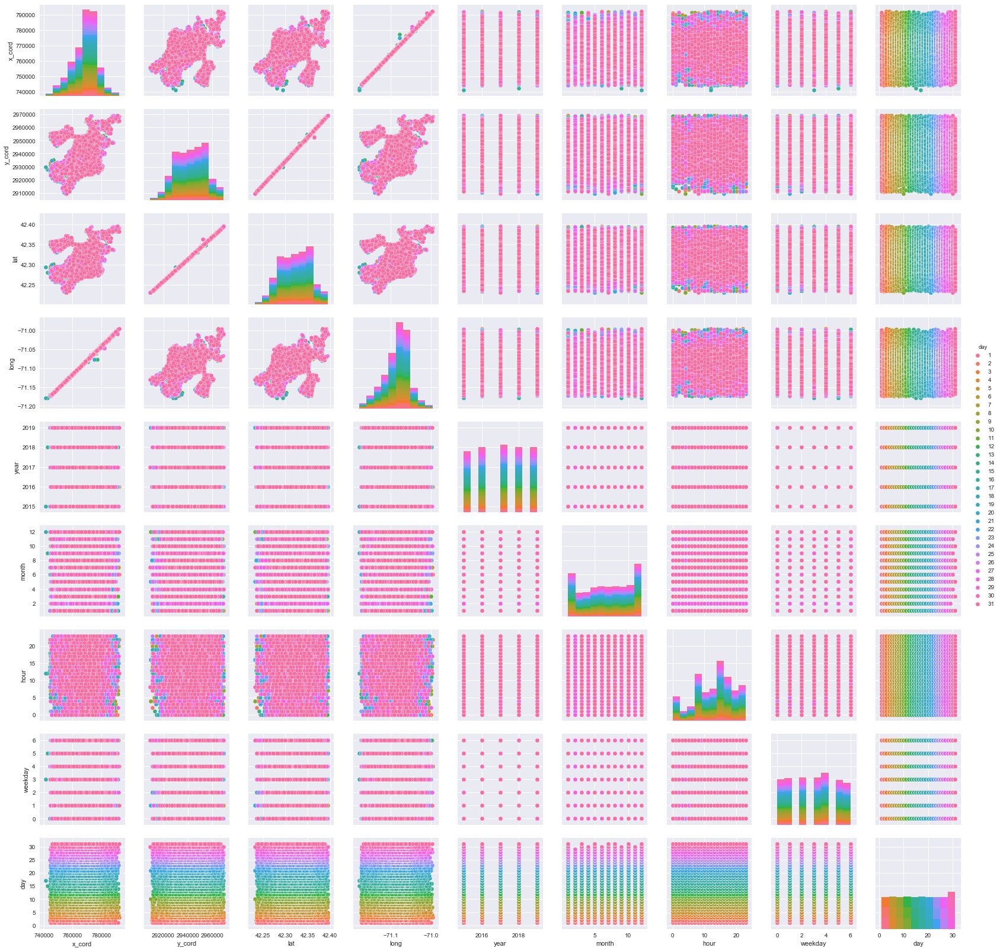

In [9]:
sns.set()
sns.pairplot(accident_data, hue='day');

# Accident Type Summary

### Aggregate by Mode Type

In [166]:
agg_mode_type = accident_data.groupby("mode_type").count()['dispatch_ts']
agg_mode_type = pd.DataFrame(agg_mode_type)
agg_mode_type = agg_mode_type.rename(columns={'dispatch_ts':'count'})
agg_mode_type

,count
mode_type,
bike,2106
mv,15785
ped,3827


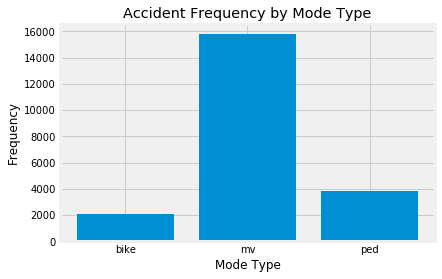

In [167]:
plt.bar(agg_mode_type.index, agg_mode_type['count'])
plt.title("Accident Frequency by Mode Type")
plt.ylabel("Frequency")
plt.xlabel("Mode Type")
plt.show()

### Aggregate by Mode Type and Year

In [168]:
agg_year_mode_type = accident_data.groupby(["year", "mode_type"]).count()['dispatch_ts']
agg_year_mode_type = agg_year_mode_type.rename(columns={'dispatch_ts':'count'})

In [169]:
# reformat grouped data
data = dict((el,[]) for el in modes)
renamed_cols = dict((i, 2015 + i) for i in range(0, len(years)))


for mode in modes:
    for yr in years:
        data[mode].append(agg_year_mode_type[:, mode][yr])
        
reformatted_agg_year = pd.DataFrame.from_dict(data)
reformatted_agg_year = reformatted_agg_year.rename(index=renamed_cols)
reformatted_agg_year

,mv,ped,bike
2015,2818,783,502
2016,3045,893,424
2017,3370,772,390
2018,3262,683,425
2019,3290,696,365


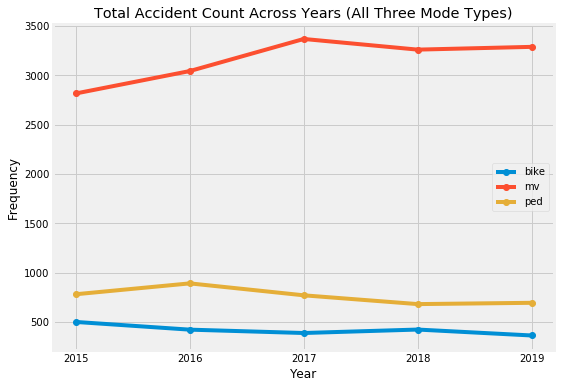

In [170]:
fig, ax = plt.subplots(1,1, figsize=(8,6))
ax.plot(reformatted_agg_year.index, reformatted_agg_year['bike'],'o-',label="bike")
ax.plot(reformatted_agg_year.index, reformatted_agg_year['mv'],'o-',label="mv")
ax.plot(reformatted_agg_year.index, reformatted_agg_year['ped'],'o-',label="ped")
plt.xticks(reformatted_agg_year.index, reformatted_agg_year.index)
ax.set_xlabel('Year')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count Across Years (All Three Mode Types)')
ax.legend(loc="center right")
plt.show()

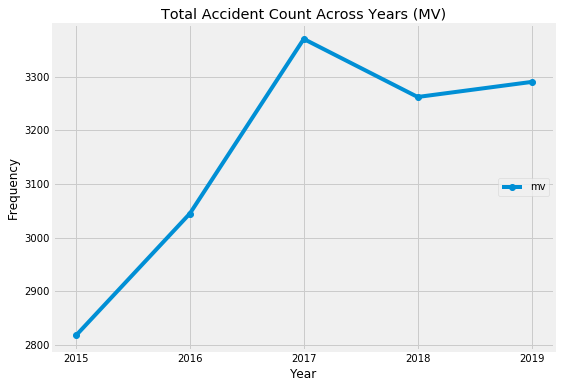

In [171]:
fig, ax = plt.subplots(1,1, figsize=(8,6))
ax.plot(reformatted_agg_year.index, reformatted_agg_year['mv'],'o-',label="mv")
plt.xticks(reformatted_agg_year.index, reformatted_agg_year.index)
ax.set_xlabel('Year')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count Across Years (MV)')
ax.legend(loc="center right")
plt.show()

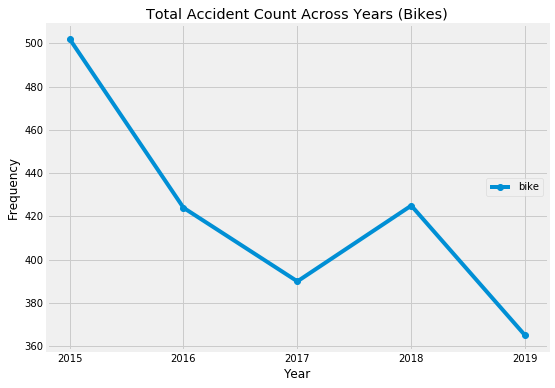

In [172]:
fig, ax = plt.subplots(1,1, figsize=(8,6))
ax.plot(reformatted_agg_year.index, reformatted_agg_year['bike'],'o-',label="bike")
plt.xticks(reformatted_agg_year.index, reformatted_agg_year.index)
ax.set_xlabel('Year')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count Across Years (Bikes)')
ax.legend(loc="center right")
plt.show()

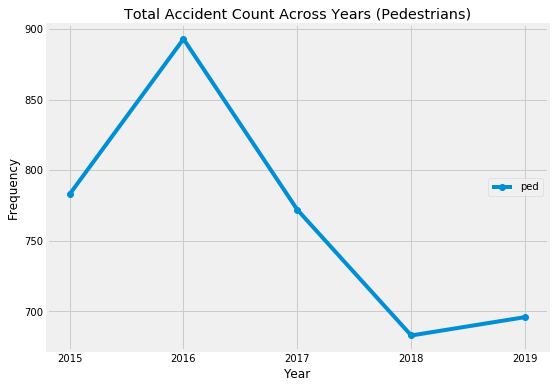

In [173]:
fig, ax = plt.subplots(1,1, figsize=(8,6))
ax.plot(reformatted_agg_year.index, reformatted_agg_year['ped'],'o-',label="ped")
plt.xticks(reformatted_agg_year.index, reformatted_agg_year.index)
ax.set_xlabel('Year')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count Across Years (Pedestrians)')
ax.legend(loc="center right")
plt.show()

## Aggregate by Mode Type and Year + Month

In [174]:
agg_year_month = accident_data.groupby(["year","month"]).count()['dispatch_ts']
agg_year_month = agg_year_month.rename(columns={'dispatch_ts':'count'})

In [175]:
axis_label = list(np.repeat(years, 12))
axis_label = [(axis_label[i], month_names[i % 12]) for i in range(len(axis_label))]
axis_label = [axis_label[i] if (i) % 6 == 0 else "" for i in range(len(axis_label))]

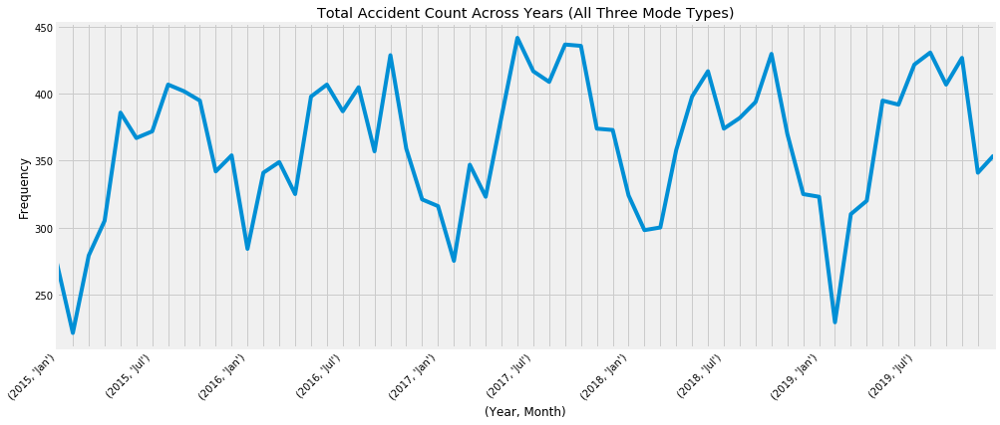

In [176]:
fig, ax = plt.subplots(figsize=(15,6))
agg_year_month.plot(ax=ax)
# plt.xticks(list(range(5*12)), axis_label)
plt.xticks(list(range(60)), axis_label, ha="right", rotation=45)
ax.set_xlabel('(Year, Month)')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count Across Years (All Three Mode Types)')
plt.show()

In [177]:
agg_year_month_mode_type = accident_data.groupby(["year","month" ,"mode_type"]).count()['dispatch_ts']
agg_year_month_mode_type = agg_year_month_mode_type.rename(columns={'dispatch_ts':'count'})

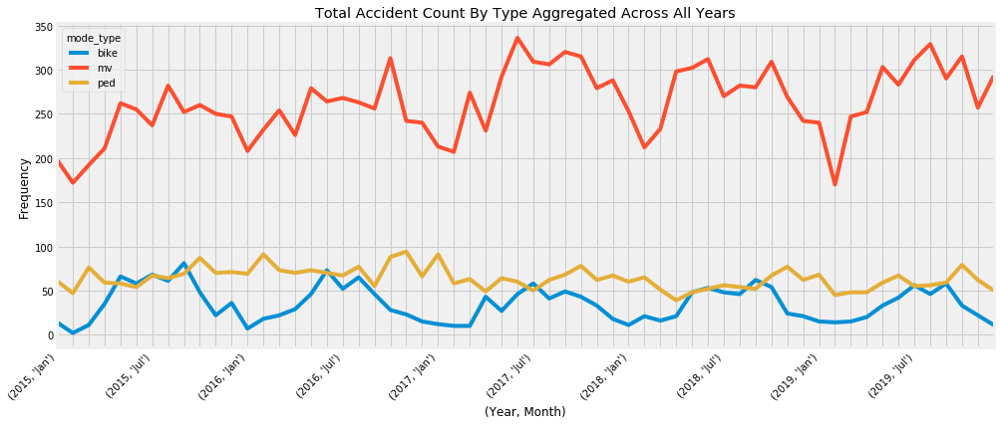

In [178]:
fig, ax = plt.subplots(figsize=(15,6))
agg_year_month_mode_type.unstack().plot(ax=ax)
plt.xticks(list(range(60)), axis_label, ha="right", rotation=45)
ax.set_xlabel('(Year, Month)')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count By Type Aggregated Across All Years')
plt.show()

### Aggregate by Mode Type and Month

In [179]:
avg_month_mode_type = accident_data.groupby(["mode_type", "month", "year"]).count()['dispatch_ts']
avg_month_mode_type = avg_month_mode_type.rename(columns={'dispatch_ts':'count'})

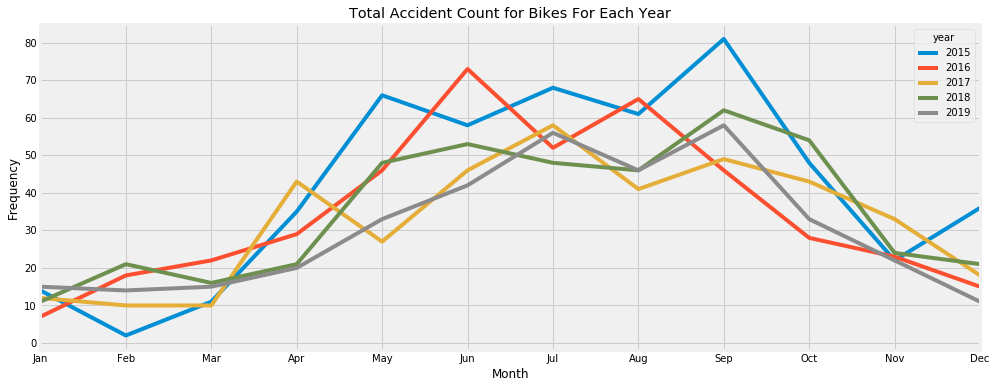

In [180]:
fig, ax = plt.subplots(figsize=(15,6))
avg_month_mode_type['bike'].unstack().plot(ax=ax)
plt.xticks(list(range(1,13)), month_names)
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count for Bikes For Each Year')
plt.show()

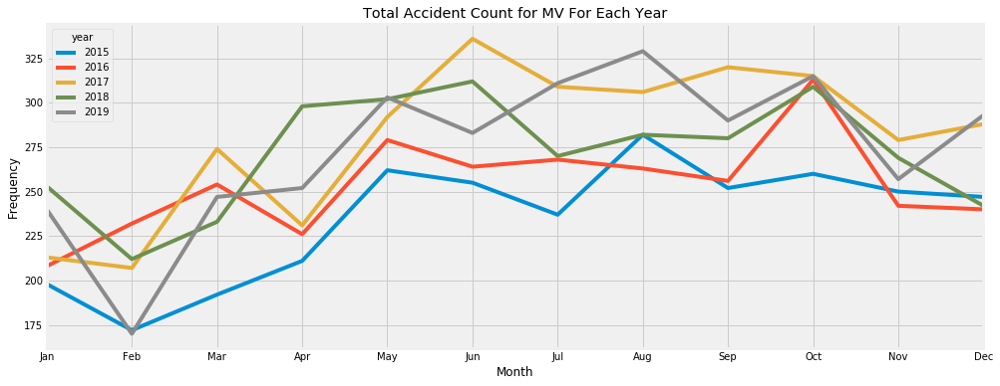

In [181]:
fig, ax = plt.subplots(figsize=(15,6))
avg_month_mode_type['mv'].unstack().plot(ax=ax)
plt.xticks(list(range(1,13)), month_names)
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count for MV For Each Year')
plt.show()

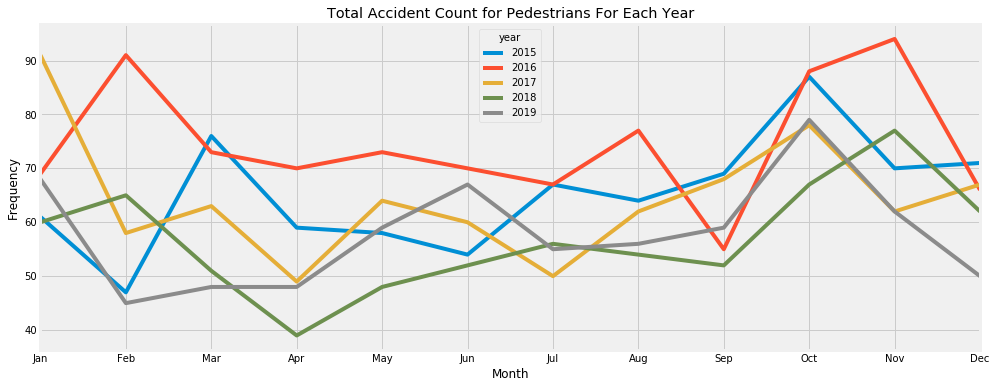

In [182]:
fig, ax = plt.subplots(figsize=(15,6))
avg_month_mode_type['ped'].unstack().plot(ax=ax)
plt.xticks(list(range(1,13)), month_names)
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count for Pedestrians For Each Year')
plt.show()

In [183]:
# reformat grouped data
data = dict((el,[]) for el in modes)
renamed_cols = dict((i, month_names[i]) for i in range(0, len(month_names)))


for mode in modes:
    for month in months:
        data[mode].append(avg_month_mode_type[mode][month].mean())
        
reformatted_avg_month = pd.DataFrame.from_dict(data)
reformatted_avg_month = reformatted_avg_month.rename(index=renamed_cols)
reformatted_avg_month

,mv,ped,bike
Jan,222.4,69.8,11.8
Feb,198.6,61.2,13.0
Mar,240.0,62.2,14.8
Apr,243.6,53.0,29.6
May,287.6,60.4,44.0
Jun,290.0,60.6,54.4
Jul,279.0,59.0,56.4
Aug,292.4,62.6,51.8
Sep,279.6,60.6,59.2
Oct,302.4,79.8,41.2


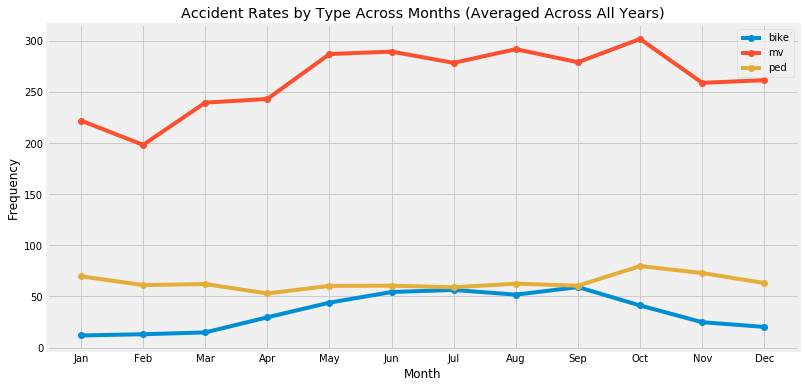

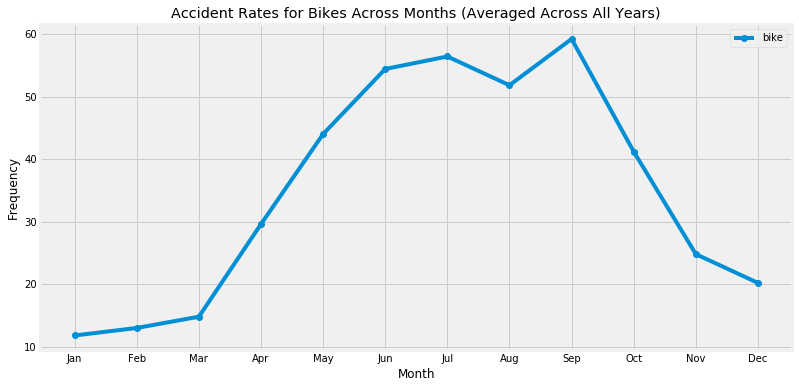

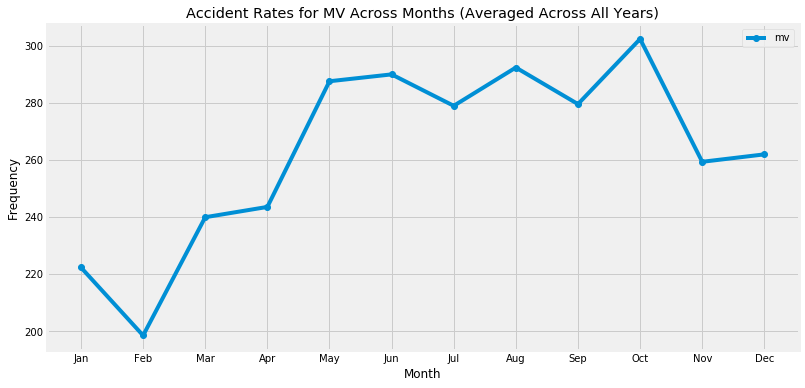

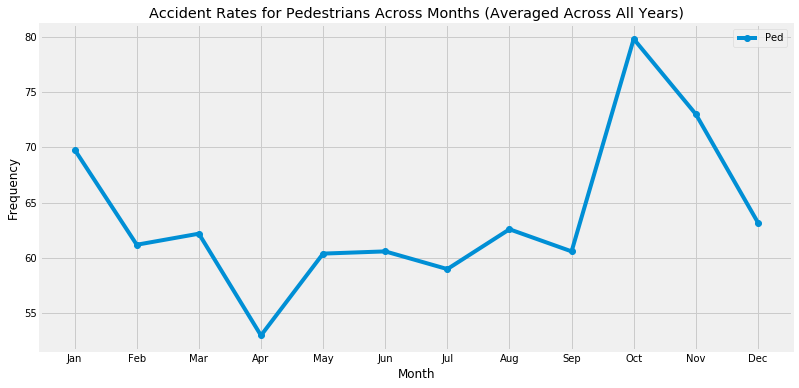

In [184]:
fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_avg_month.index, reformatted_avg_month['bike'],'o-', label="bike")
ax.plot(reformatted_avg_month.index, reformatted_avg_month['mv'],'o-', label="mv")
ax.plot(reformatted_avg_month.index, reformatted_avg_month['ped'],'o-', label="ped")
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates by Type Across Months (Averaged Across All Years)')
ax.legend(loc="upper right")
plt.show()

fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_avg_month.index, reformatted_avg_month['bike'],'o-', label="bike")
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates for Bikes Across Months (Averaged Across All Years)')
ax.legend(loc="upper right")
plt.show()

fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_avg_month.index, reformatted_avg_month['mv'],'o-', label="mv")
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates for MV Across Months (Averaged Across All Years)')
ax.legend(loc="upper right")
plt.show()

fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_avg_month.index, reformatted_avg_month['ped'],'o-', label="Ped")
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates for Pedestrians Across Months (Averaged Across All Years)')
ax.legend(loc="upper right")
plt.show()

In [185]:
agg_month_mode_type = accident_data.groupby(["month", "mode_type"]).count()['dispatch_ts']
agg_month_mode_type = agg_month_mode_type.rename(columns={'dispatch_ts':'count'})

In [186]:
# reformat grouped data
data = dict((el,[]) for el in modes)
renamed_cols = dict((i, month_names[i]) for i in range(0, len(month_names)))


for mode in modes:
    for month in months:
        data[mode].append(agg_month_mode_type[:, mode][month])
        
reformatted_agg_month = pd.DataFrame.from_dict(data)
reformatted_agg_month = reformatted_agg_month.rename(index=renamed_cols)
reformatted_agg_month

,mv,ped,bike
Jan,1112,349,59
Feb,993,306,65
Mar,1200,311,74
Apr,1218,265,148
May,1438,302,220
Jun,1450,303,272
Jul,1395,295,282
Aug,1462,313,259
Sep,1398,303,296
Oct,1512,399,206


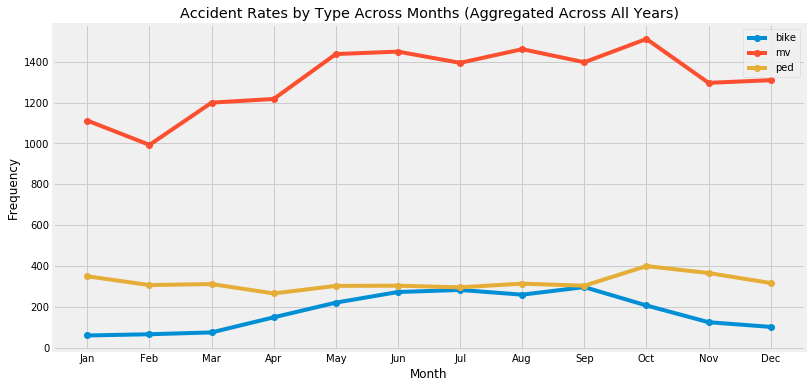

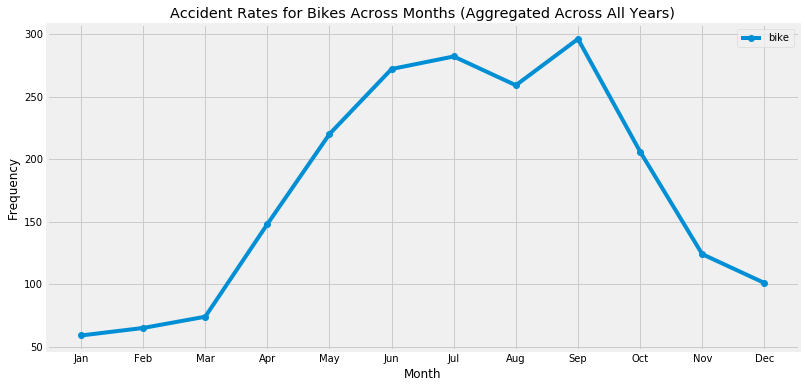

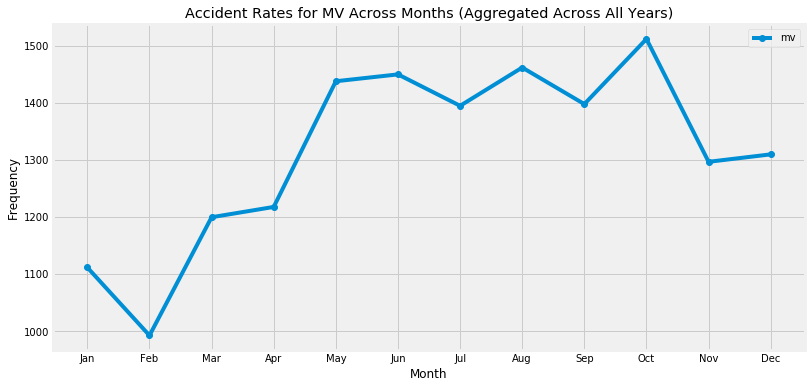

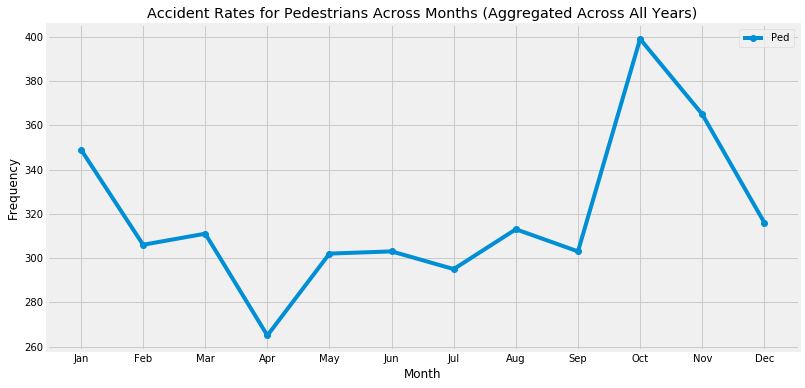

In [187]:
fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_agg_month.index, reformatted_agg_month['bike'],'o-', label="bike")
ax.plot(reformatted_agg_month.index, reformatted_agg_month['mv'],'o-', label="mv")
ax.plot(reformatted_agg_month.index, reformatted_agg_month['ped'],'o-', label="ped")
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates by Type Across Months (Aggregated Across All Years)')
ax.legend(loc="upper right")
plt.show()

fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_agg_month.index, reformatted_agg_month['bike'],'o-', label="bike")
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates for Bikes Across Months (Aggregated Across All Years)')
ax.legend(loc="upper right")
plt.show()

fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_agg_month.index, reformatted_agg_month['mv'],'o-', label="mv")
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates for MV Across Months (Aggregated Across All Years)')
ax.legend(loc="upper right")
plt.show()

fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_agg_month.index, reformatted_agg_month['ped'],'o-', label="Ped")
ax.set_xlabel('Month')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates for Pedestrians Across Months (Aggregated Across All Years)')
ax.legend(loc="upper right")
plt.show()

In [188]:
march_school = accident_data[(accident_data["month"] == 3) & 
                          ((accident_data["weekday"] != 5)) &
                          ((accident_data["weekday"] != 6)) &
                  (((accident_data["hour"] >= 8) & (accident_data["hour"] <= 9)) | 
                  ((accident_data["hour"] >= 15) & (accident_data["hour"] <= 16)))]

In [189]:
school_acc = []
total_acc = []

for i in range(1, 13):
    s = len(accident_data[(accident_data["month"] == i) & 
                          ((accident_data["weekday"] != 5)) &
                          ((accident_data["weekday"] != 6)) &
                  (((accident_data["hour"] >= 8) & (accident_data["hour"] <= 9)) | 
                  ((accident_data["hour"] >= 15) & (accident_data["hour"] <= 16)))])
    t = len(accident_data[accident_data["month"] == i])
    school_acc.append(s)
    total_acc.append(t)

In [190]:
school_data = {"months": month_names,"school_acc": school_acc, "total_acc": total_acc}
school_acc_df = pd.DataFrame(school_data)
school_acc_df["ratio"] = school_acc_df["school_acc"] / school_acc_df["total_acc"]

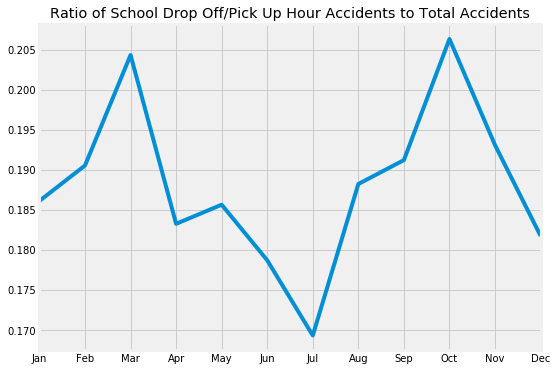

In [191]:
fig, ax = plt.subplots(figsize=(8,6))
school_acc_df["ratio"].plot()
plt.xticks(list(range(12)), month_names)
plt.title("Ratio of School Drop Off/Pick Up Hour Accidents to Total Accidents")
plt.show()

### Aggregate by Mode Type and Hour of Day

In [192]:
am = [12] + list(range(1,12))
pm = [12] + list(range(1,12))
am = [str(time) + "am" for time in am]
pm = [str(time) + "pm" for time in pm]
times = am + pm

In [193]:
agg_year_hour = accident_data.groupby(["year","hour"]).count()['dispatch_ts']
agg_year_hour = agg_year_hour.rename(columns={'dispatch_ts':'count'})

In [194]:
axis_label = list(np.repeat(years, 24))
axis_label = [(axis_label[i], times[i % 24]) for i in range(len(axis_label))]
axis_label = [axis_label[i] if (i) % 12 == 0 else "" for i in range(len(axis_label))]

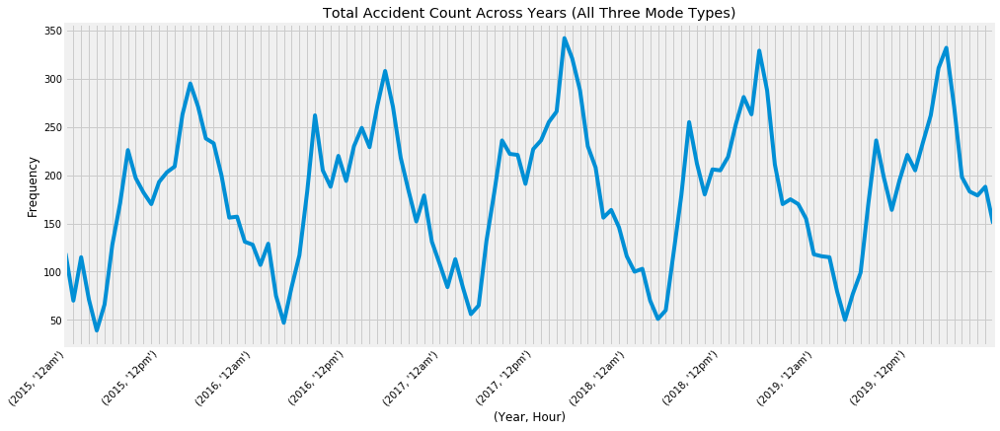

In [195]:
fig, ax = plt.subplots(figsize=(15,6))
agg_year_hour.plot(ax=ax)
plt.xticks(list(range(5*24)), axis_label, ha="right", rotation=45)
ax.set_xlabel('(Year, Hour)')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count Across Years (All Three Mode Types)')
plt.show()

In [196]:
agg_year_hour_mode_type = accident_data.groupby(["year","hour" ,"mode_type"]).count()['dispatch_ts']
agg_year_hour_mode_type = agg_year_hour_mode_type.rename(columns={'dispatch_ts':'count'})

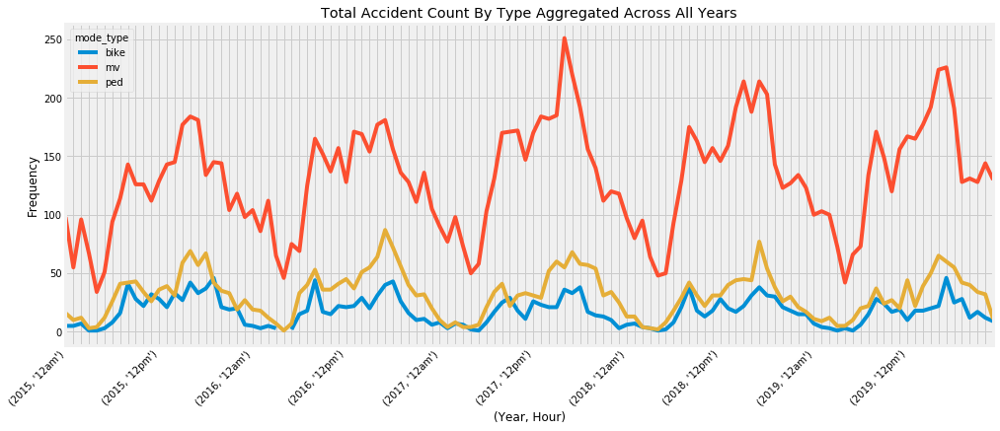

In [197]:
fig, ax = plt.subplots(figsize=(15,6))
agg_year_hour_mode_type.unstack().plot(ax=ax)
plt.xticks(list(range(5*24)), axis_label, ha="right", rotation=45)
ax.set_xlabel('(Year, Hour)')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count By Type Aggregated Across All Years')
plt.show()

In [198]:
agg_hour_mode_type = accident_data.groupby(["hour", "mode_type"]).count()['dispatch_ts']
agg_hour_mode_type = agg_hour_mode_type.rename(columns={'dispatch_ts':'count'})

In [199]:
# reformat grouped data
data = dict((el,[]) for el in modes)
renamed_cols = dict((i, times[i]) for i in range(0, len(times)))

for mode in modes:
    for hr in hours:
        data[mode].append(agg_hour_mode_type[:, mode][hr])
        
reformatted_agg_hour = pd.DataFrame.from_dict(data)
reformatted_agg_hour = reformatted_agg_hour.rename(index=renamed_cols)
reformatted_agg_hour

,mv,ped,bike
12am,489,69,31
1am,342,22,14
2am,700,150,85
3am,876,306,174
4am,432,118,45
5am,824,215,176
6am,740,187,113
7am,822,167,104
8am,865,217,118
9am,652,138,68


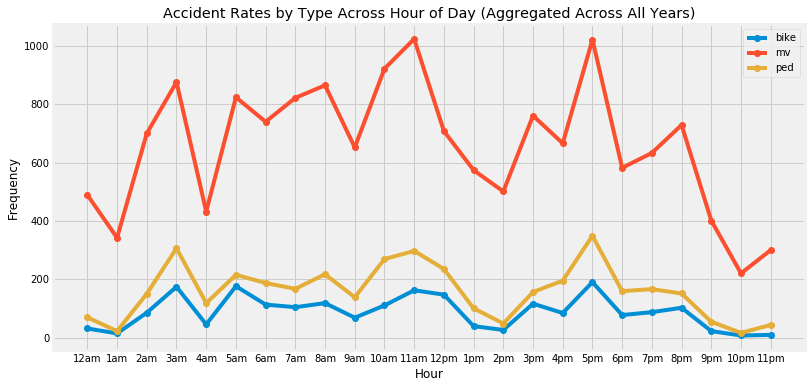

In [200]:
fig, ax = plt.subplots(1,1, figsize=(12,6))
ax.plot(reformatted_agg_hour.index, reformatted_agg_hour['bike'],'o-',label="bike")
ax.plot(reformatted_agg_hour.index, reformatted_agg_hour['mv'],'o-',label="mv")
ax.plot(reformatted_agg_hour.index, reformatted_agg_hour['ped'],'o-',label="ped")
ax.set_xlabel('Hour')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates by Type Across Hour of Day (Aggregated Across All Years)')
ax.legend(loc="upper right")

### Aggregate by Mode Type and Day of Week

In [250]:
days = ['Mon', 'Tues', 'Wed', 'Thurs', 'Fri', 'Sat', 'Sun']

In [251]:
agg_year_day = accident_data.groupby(["year","weekday"]).count()['dispatch_ts']
agg_year_day = agg_year_day.rename(columns={'dispatch_ts':'count'})

In [252]:
axis_label = list(np.repeat(years, 7))
axis_label = [(axis_label[i], days[i % 7]) for i in range(len(axis_label))]
axis_label = [axis_label[i] if (i % 7 == 0) else "" for i in range(len(axis_label))]

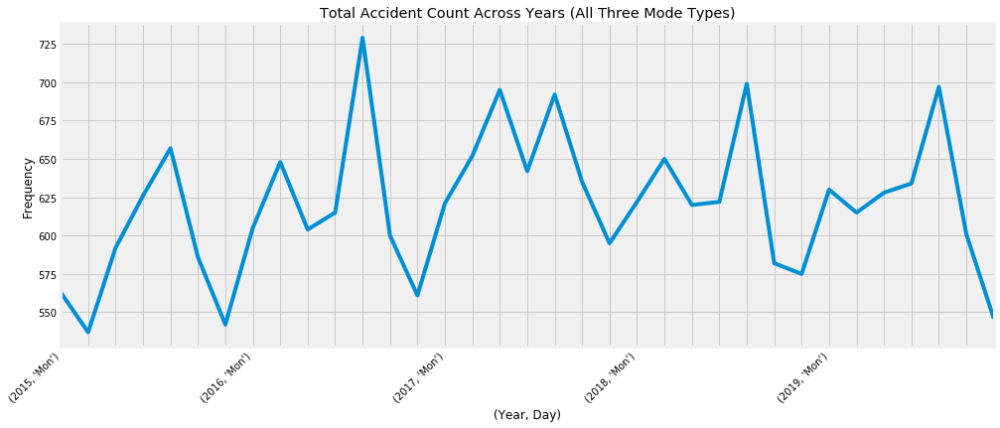

In [253]:
fig, ax = plt.subplots(figsize=(15,6))
agg_year_day.plot(ax=ax)
plt.xticks(list(range(5*7)), axis_label, ha="right", rotation=45)
ax.set_xlabel('(Year, Day)')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count Across Years (All Three Mode Types)')
plt.show()

In [254]:
day_ratio = []
for i in range(7):
    day_ratio.append(len(accident_data[accident_data["weekday"] == i]) / len(accident_data))
    
day_ratio

[0.14002210148264113,
 0.14283083156828438,
 0.14453448752187126,
 0.14453448752187126,
 0.15995948061515794,
 0.13831844552905423,
 0.1298001657611198]

In [255]:
agg_year_day_mode_type = accident_data.groupby(["year","weekday" ,"mode_type"]).count()['dispatch_ts']
agg_year_day_mode_type = agg_year_day_mode_type.rename(columns={'dispatch_ts':'count'})

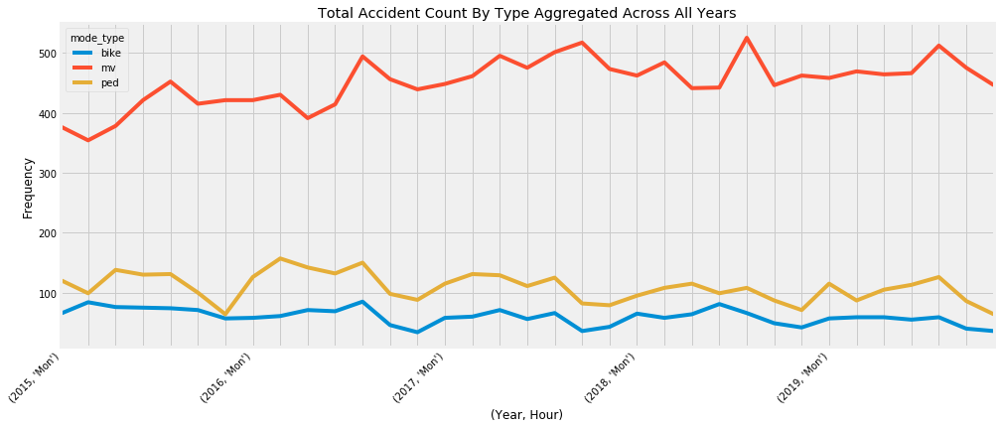

In [256]:
fig, ax = plt.subplots(figsize=(15,6))
agg_year_day_mode_type.unstack().plot(ax=ax)
plt.xticks(list(range(5*7)), axis_label, ha="right", rotation=45)
ax.set_xlabel('(Year, Hour)')
ax.set_ylabel('Frequency')
ax.set_title('Total Accident Count By Type Aggregated Across All Years')
plt.show()

In [257]:
agg_weekday_mode_type = accident_data.groupby(["weekday", "mode_type"]).count()['dispatch_ts']
agg_weekday_mode_type = agg_weekday_mode_type.rename(columns={'dispatch_ts':'count'})

In [258]:
# reformat grouped data
data = dict((el,[]) for el in modes)
renamed_cols = dict((i, days[i]) for i in range(0, len(weekdays)))


for mode in modes:
    for day in range(0, len(weekdays)):
        data[mode].append(agg_weekday_mode_type[:, mode][day])
        
reformatted_agg_weekday = pd.DataFrame.from_dict(data)
reformatted_agg_weekday = reformatted_agg_weekday.rename(index=renamed_cols)
reformatted_agg_weekday

,mv,ped,bike
Mon,2166,572,303
Tues,2198,582,322
Wed,2169,629,341
Thurs,2218,585,336
Fri,2484,640,350
Sat,2309,453,242
Sun,2241,366,212


In [259]:
len(accident_data[(accident_data["mode_type"] == "ped") & (accident_data["weekday"] == 5)])

453

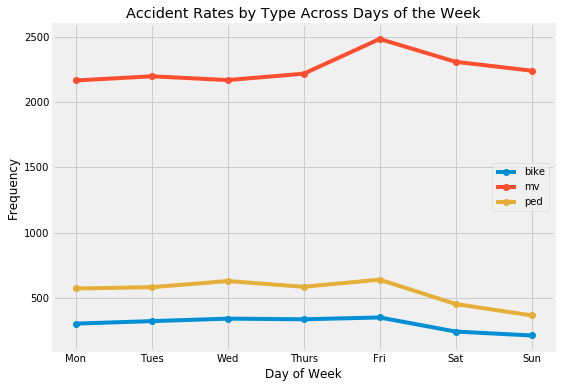

In [264]:
# Monday = 0
# Sunday = 6
fig, ax = plt.subplots(1,1, figsize=(8,6))
ax.plot(reformatted_agg_weekday.index, reformatted_agg_weekday['bike'],'o-',label="bike")
ax.plot(reformatted_agg_weekday.index, reformatted_agg_weekday['mv'],'o-',label="mv")
ax.plot(reformatted_agg_weekday.index, reformatted_agg_weekday['ped'],'o-',label="ped")
ax.set_xlabel('Day of Week')
ax.set_ylabel('Frequency')
ax.set_title('Accident Rates by Type Across Days of the Week')
ax.legend(loc="center right")

### Aggregate by Mode Type and Location

In [50]:
agg_loc_mode_type = accident_data.groupby(["location_type", "mode_type"]).count()['dispatch_ts']
agg_loc_mode_type = agg_loc_mode_type.rename(columns={'dispatch_ts':'count'})

In [51]:
# reformat grouped data
data = dict((el,[]) for el in modes)
renamed_cols = dict((i, loc_types[i]) for i in range(0, len(loc_types)))


for mode in modes:
    for loc_type in loc_types:
        data[mode].append(agg_loc_mode_type[:, mode][loc_type])
        
reformatted_agg_loc = pd.DataFrame.from_dict(data)
reformatted_agg_loc = reformatted_agg_loc.rename(index=renamed_cols)
reformatted_agg_loc

,bike,mv,ped
Intersection,1065,7687,1948
Street,1000,6390,1849
Other,41,1708,30


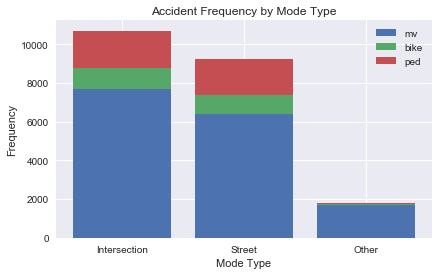

In [52]:
bars = np.add(reformatted_agg_loc['bike'], reformatted_agg_loc['mv']).tolist()

b1 = plt.bar(reformatted_agg_loc.index, reformatted_agg_loc['mv'])
b2 = plt.bar(reformatted_agg_loc.index, reformatted_agg_loc['bike'], bottom=reformatted_agg_loc['mv'])
b3 = plt.bar(reformatted_agg_loc.index, reformatted_agg_loc['ped'], bottom=bars)
plt.title("Accident Frequency by Mode Type")
plt.ylabel("Frequency")
plt.xlabel("Mode Type")
plt.legend([b1, b2, b3],["mv", "bike", "ped"], loc="upper right")
plt.show()

# Map Visualizations

In [8]:
# import decartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

In [9]:
geometry = [Point(xy) for xy in zip(accident_data['long'], accident_data['lat'])]
geo_df = gpd.GeoDataFrame(accident_data, crs={'init':'epsg:4326'}, geometry = geometry)

# MV Maps

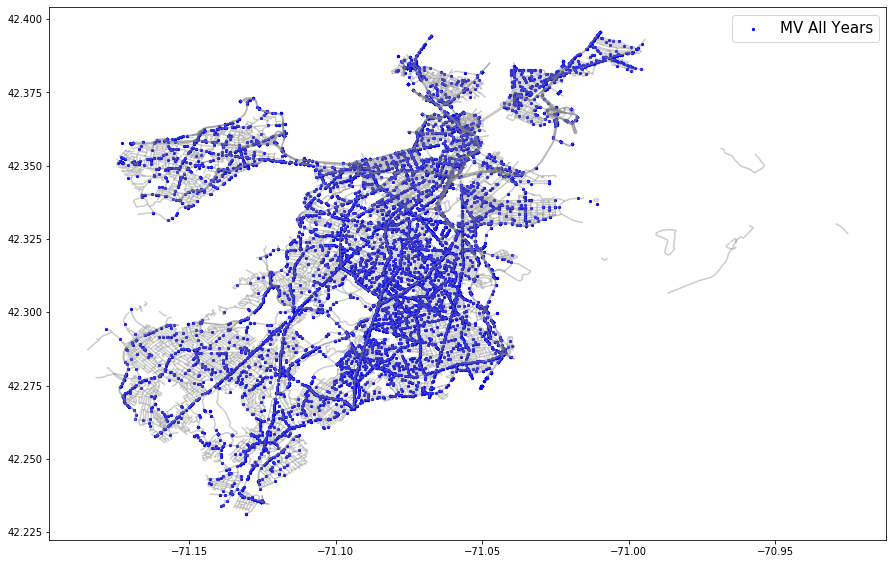

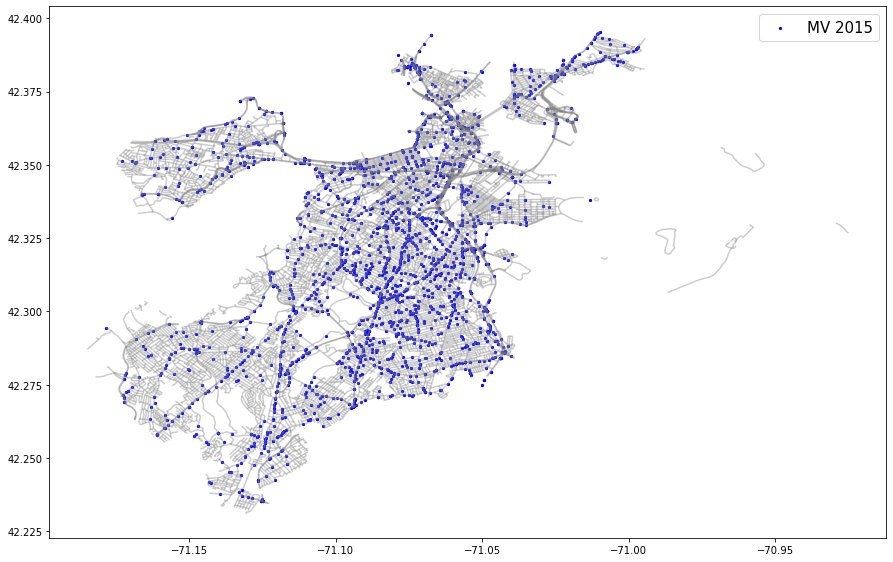

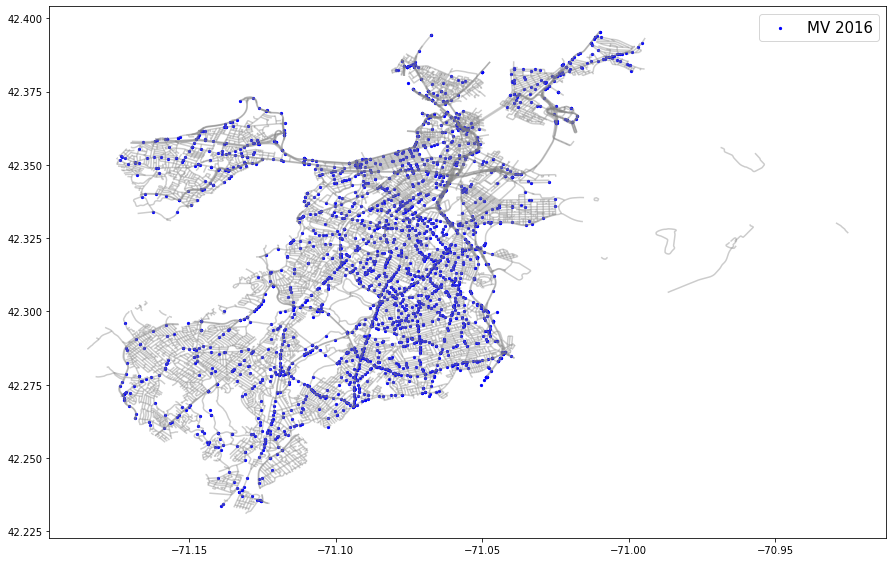

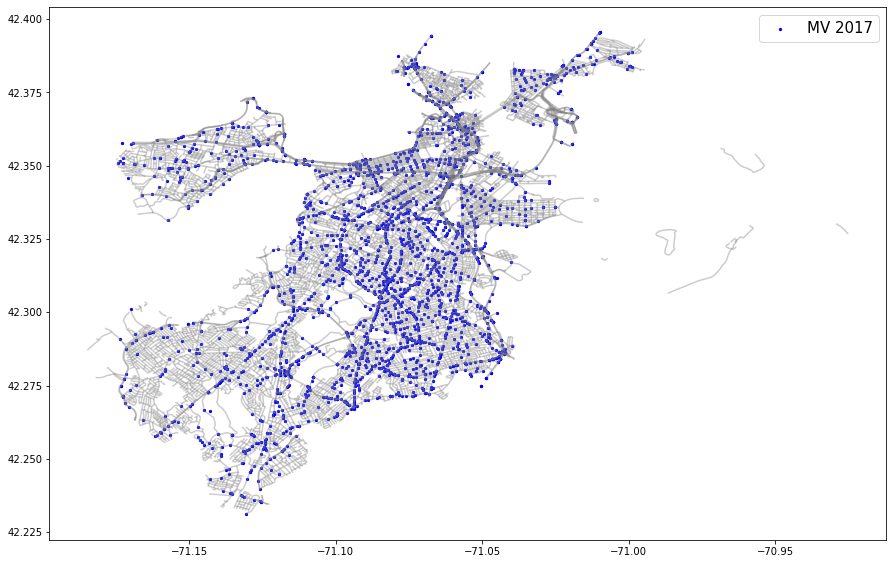

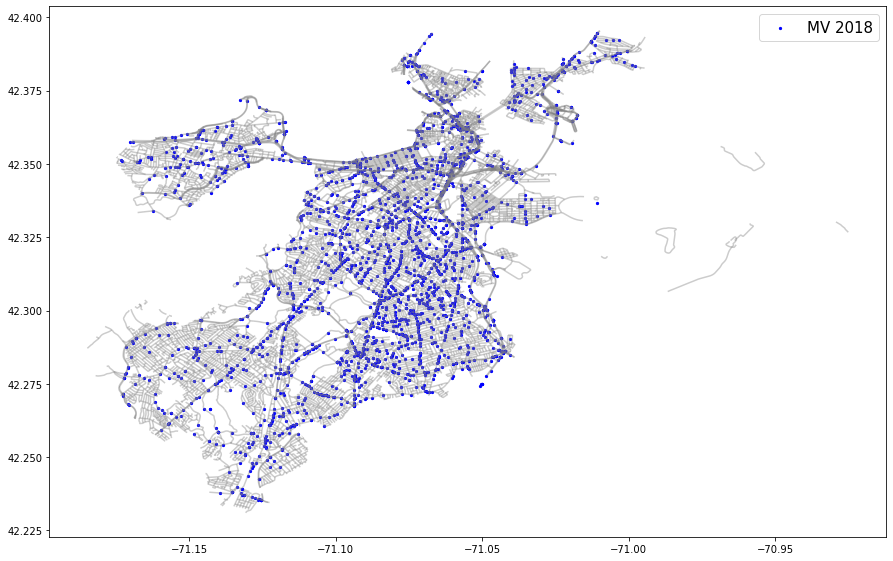

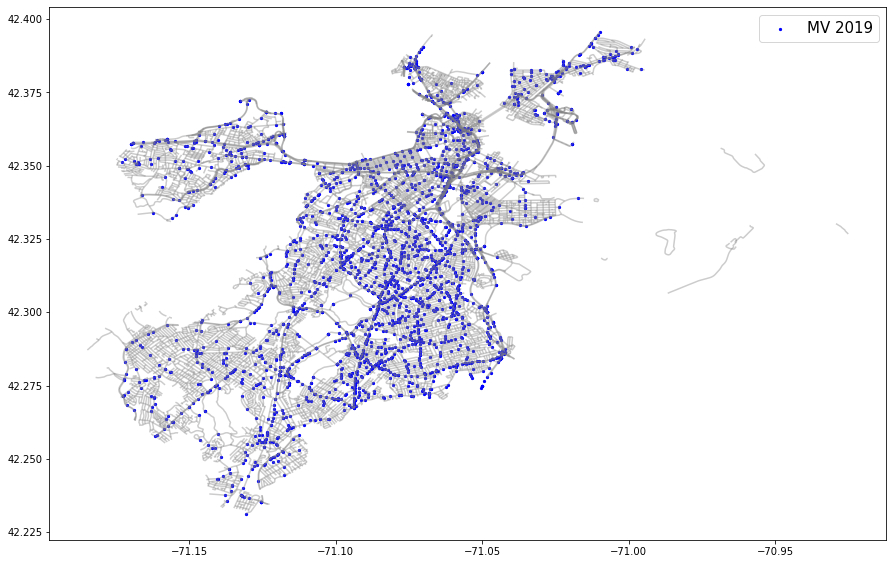

In [67]:
street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "mv")].plot(ax = ax, markersize = 5, color="blue", marker="o", label="MV All Years")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "mv") & 
       (geo_df["year"] == 2015)].plot(ax = ax, markersize = 5, color="blue", marker="o", label="MV 2015")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "mv") & 
       (geo_df["year"] == 2016)].plot(ax = ax, markersize = 5, color="blue", marker="o", label="MV 2016")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "mv") & 
       (geo_df["year"] == 2017)].plot(ax = ax, markersize = 5, color="blue", marker="o", label="MV 2017")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "mv") & 
       (geo_df["year"] == 2018)].plot(ax = ax, markersize = 5, color="blue", marker="o", label="MV 2018")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "mv") & 
       (geo_df["year"] == 2019)].plot(ax = ax, markersize = 5, color="blue", marker="o", label="MV 2019")
plt.legend(prop={'size': 15})

# Bike Maps

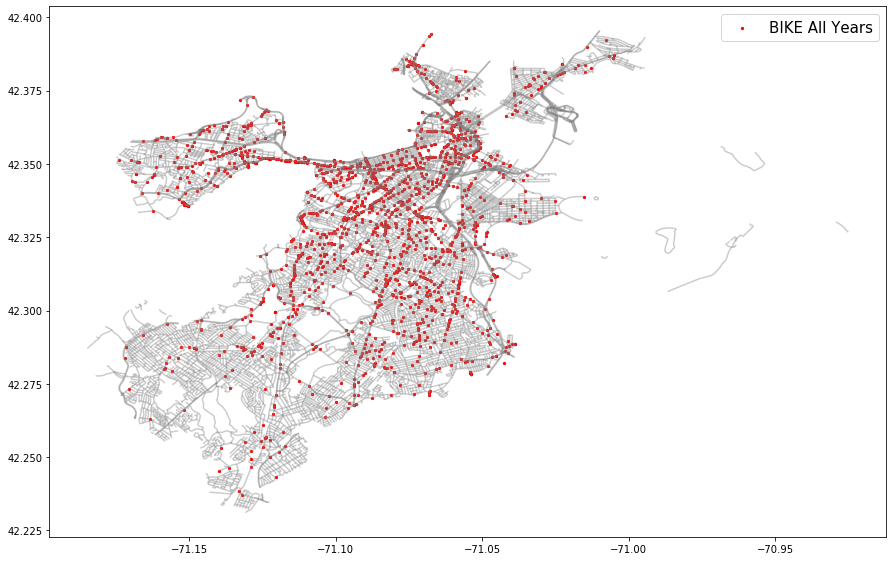

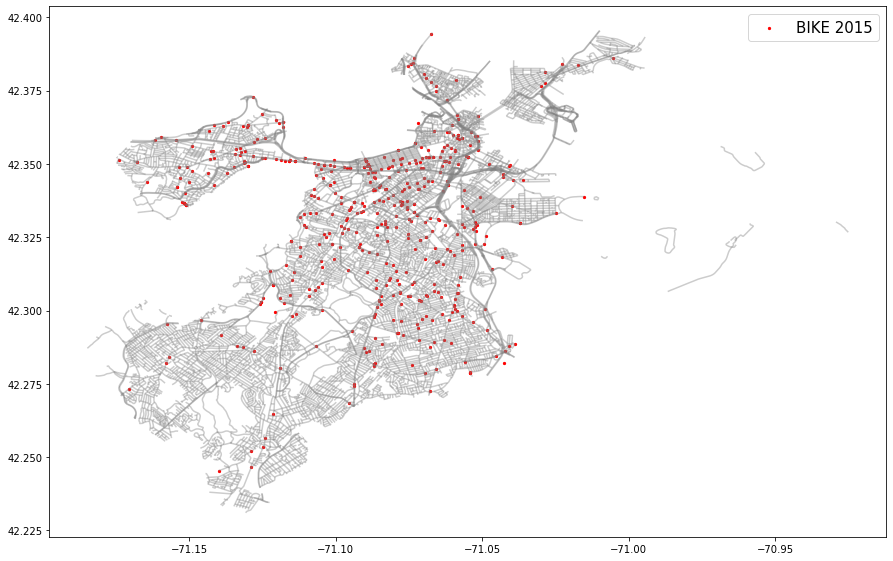

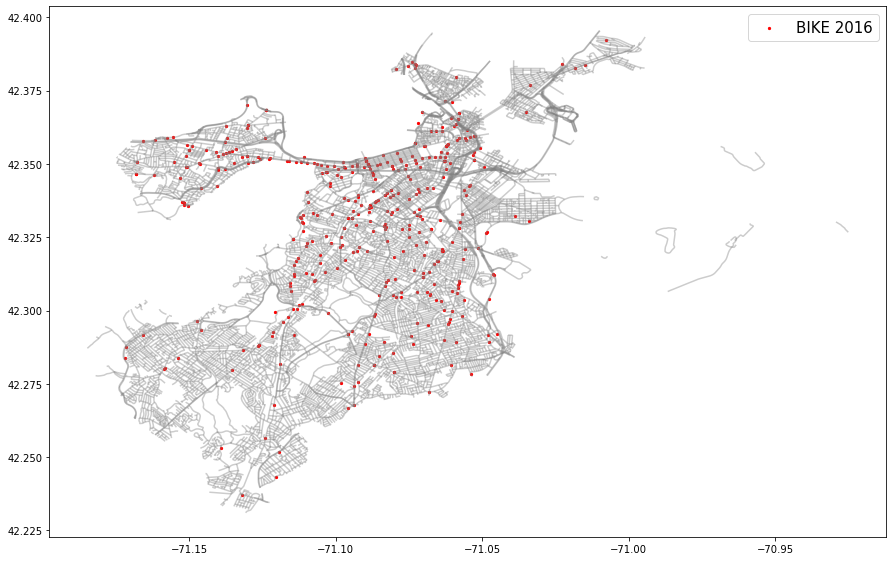

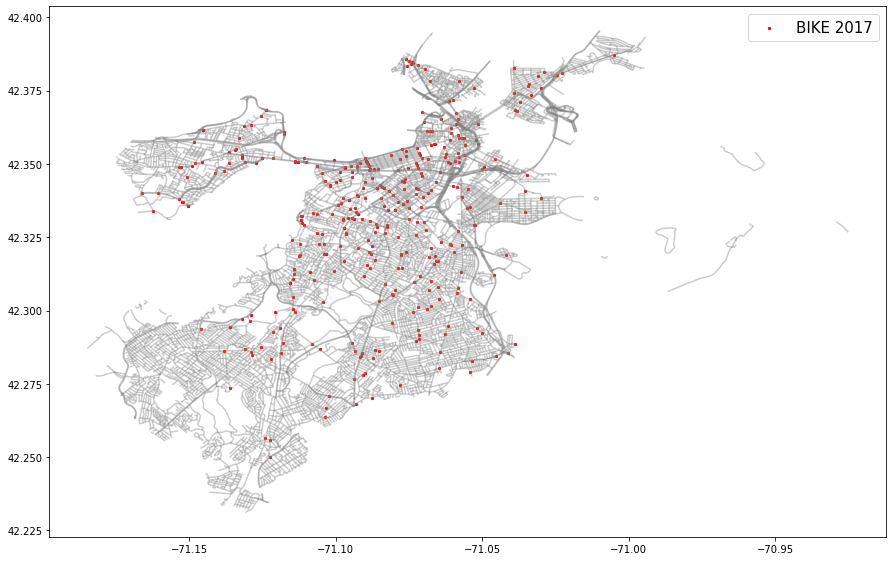

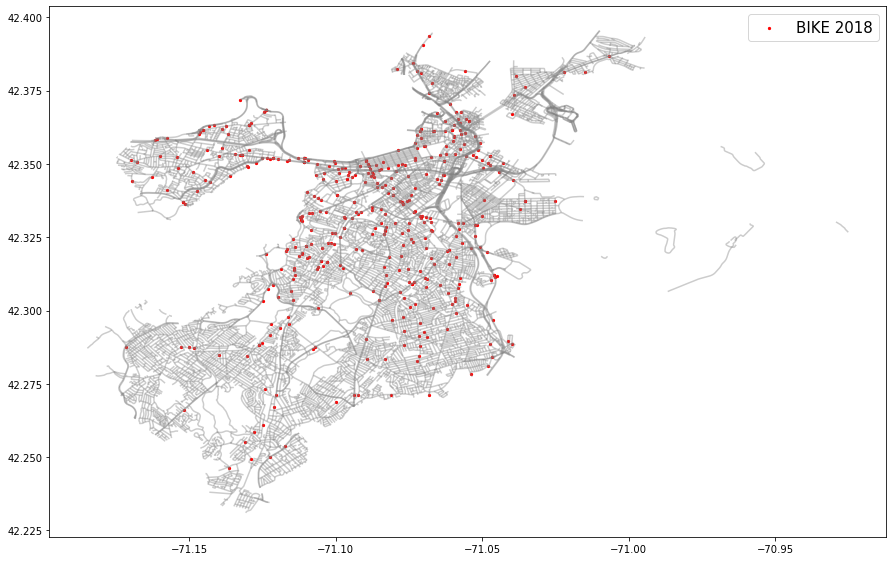

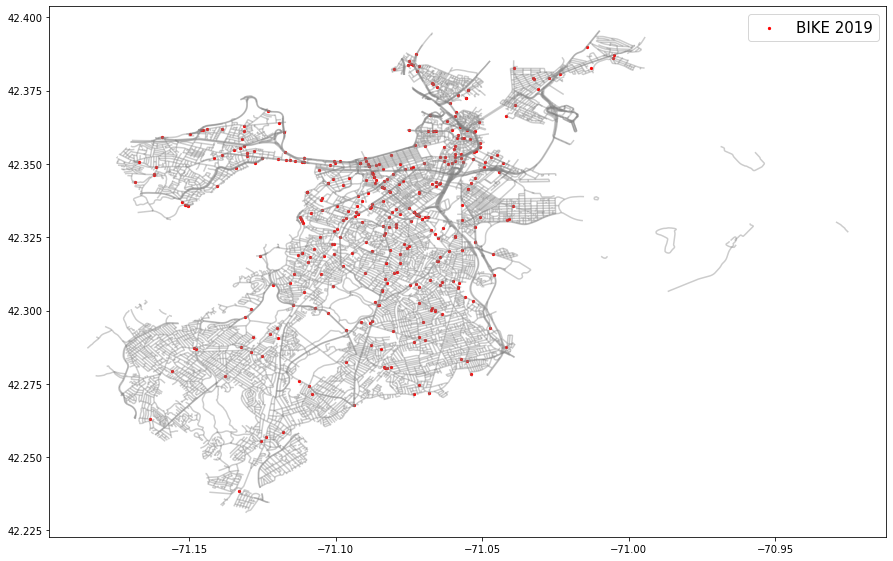

In [68]:
street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "bike")].plot(ax = ax, markersize = 5, color="red", marker="o", label="BIKE All Years")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "bike") & 
       (geo_df["year"] == 2015)].plot(ax = ax, markersize = 5, color="red", marker="o", label="BIKE 2015")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "bike") & 
       (geo_df["year"] == 2016)].plot(ax = ax, markersize = 5, color="red", marker="o", label="BIKE 2016")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "bike") & 
       (geo_df["year"] == 2017)].plot(ax = ax, markersize = 5, color="red", marker="o", label="BIKE 2017")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "bike") & 
       (geo_df["year"] == 2018)].plot(ax = ax, markersize = 5, color="red", marker="o", label="BIKE 2018")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "bike") & 
       (geo_df["year"] == 2019)].plot(ax = ax, markersize = 5, color="red", marker="o", label="BIKE 2019")
plt.legend(prop={'size': 15})

# Ped Maps

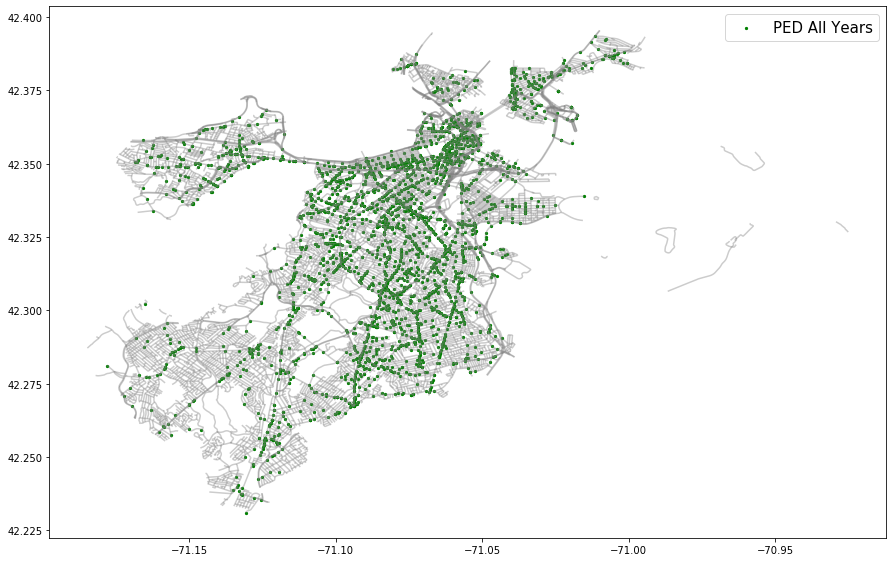

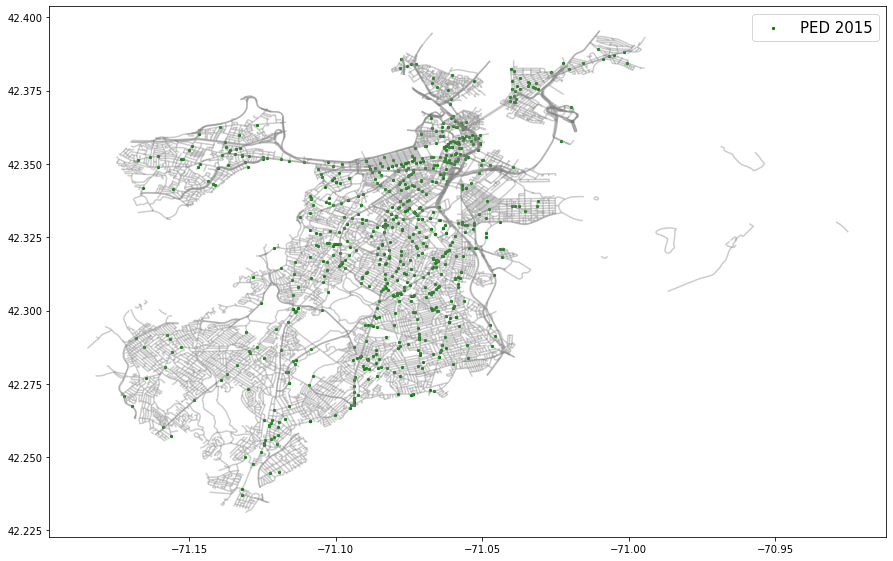

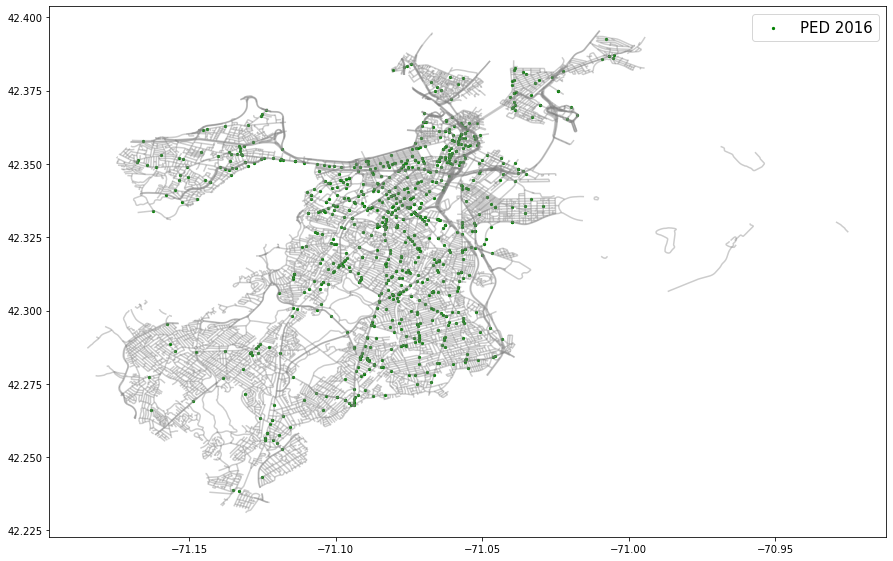

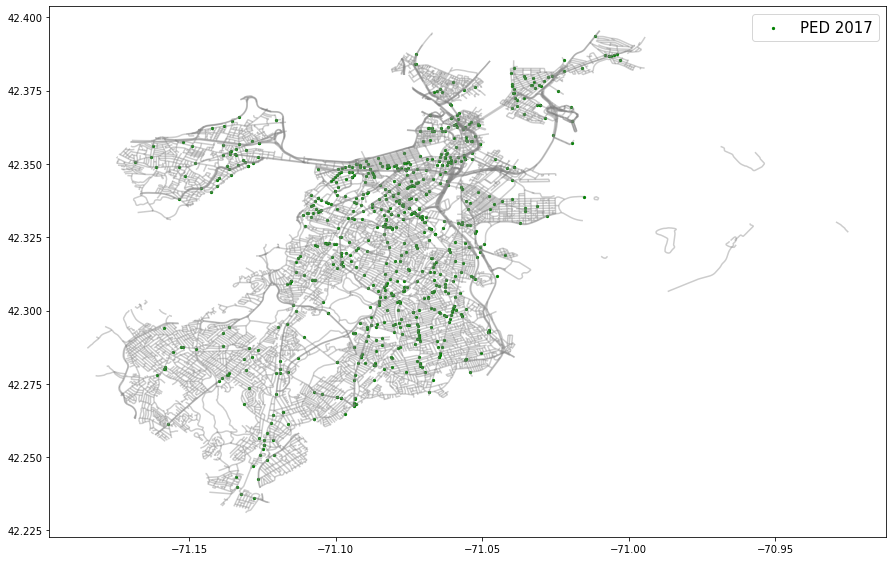

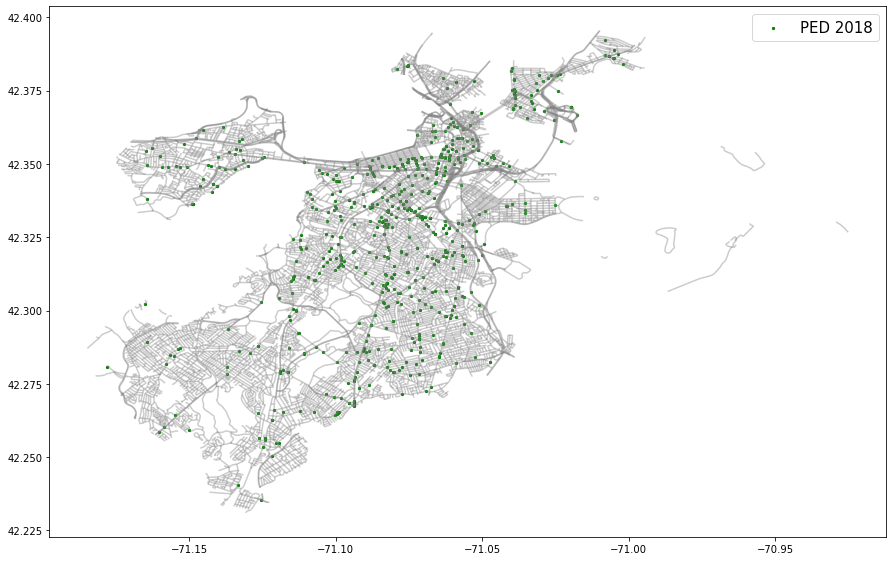

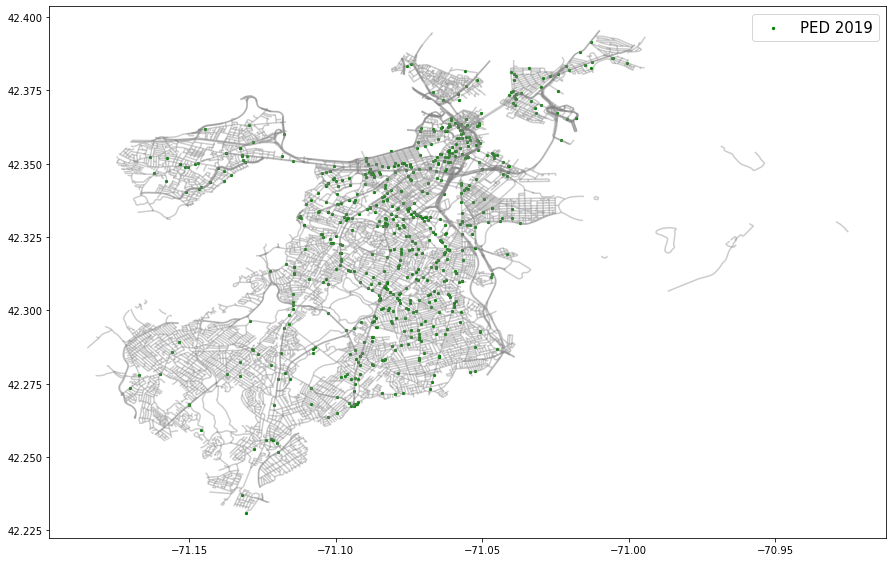

In [69]:
street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "ped")].plot(ax = ax, markersize = 5, color="green", marker="o", label="PED All Years")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "ped") & 
       (geo_df["year"] == 2015)].plot(ax = ax, markersize = 5, color="green", marker="o", label="PED 2015")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "ped") & 
       (geo_df["year"] == 2016)].plot(ax = ax, markersize = 5, color="green", marker="o", label="PED 2016")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "ped") & 
       (geo_df["year"] == 2017)].plot(ax = ax, markersize = 5, color="green", marker="o", label="PED 2017")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "ped") & 
       (geo_df["year"] == 2018)].plot(ax = ax, markersize = 5, color="green", marker="o", label="PED 2018")
plt.legend(prop={'size': 15})

street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
fig, ax = plt.subplots(figsize=(15,15))
street_map.plot(ax = ax, alpha = 0.4, color="grey")
geo_df[(geo_df["mode_type"] == "ped") & 
       (geo_df["year"] == 2019)].plot(ax = ax, markersize = 5, color="green", marker="o", label="PED 2019")
plt.legend(prop={'size': 15})

# Month Maps

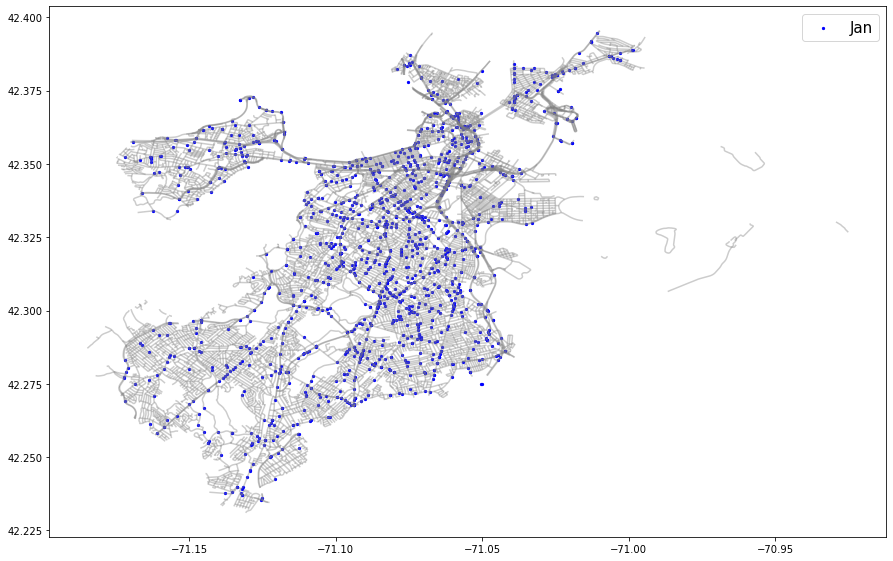

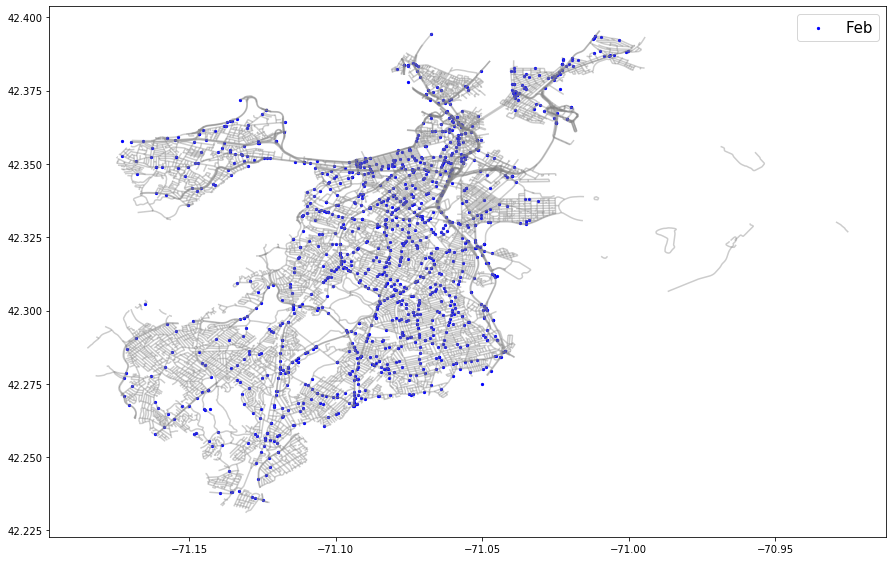

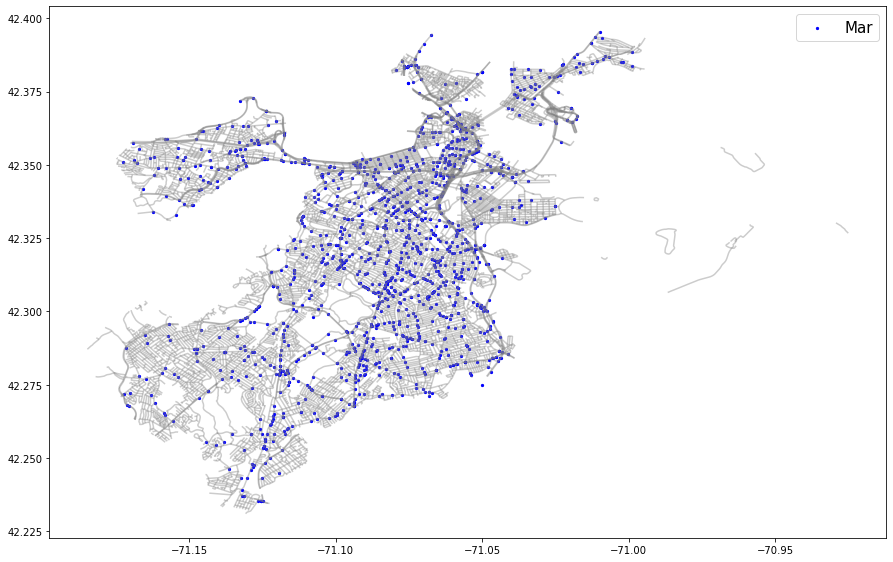

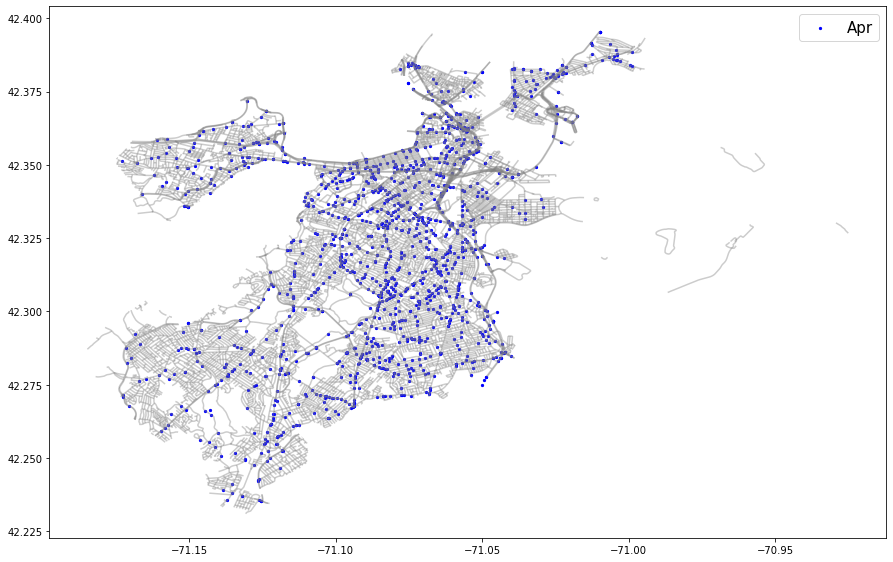

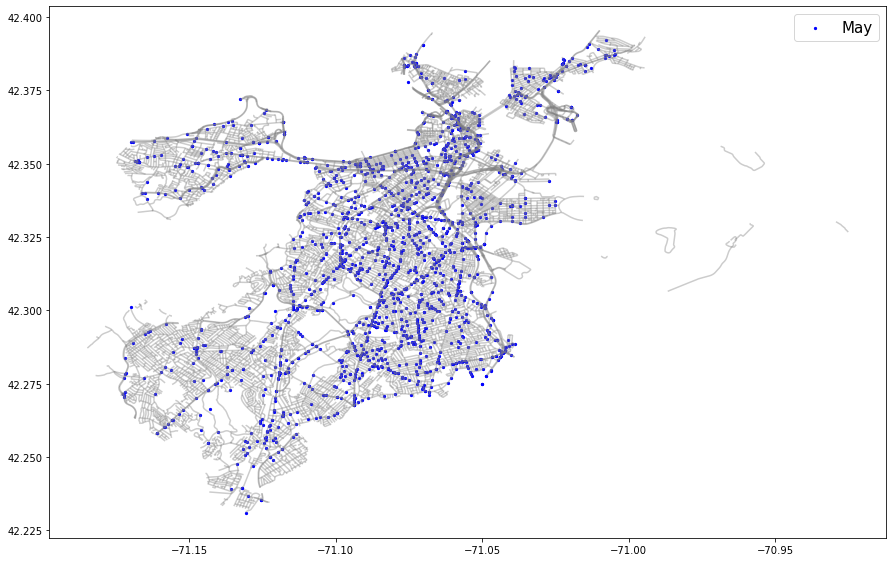

...

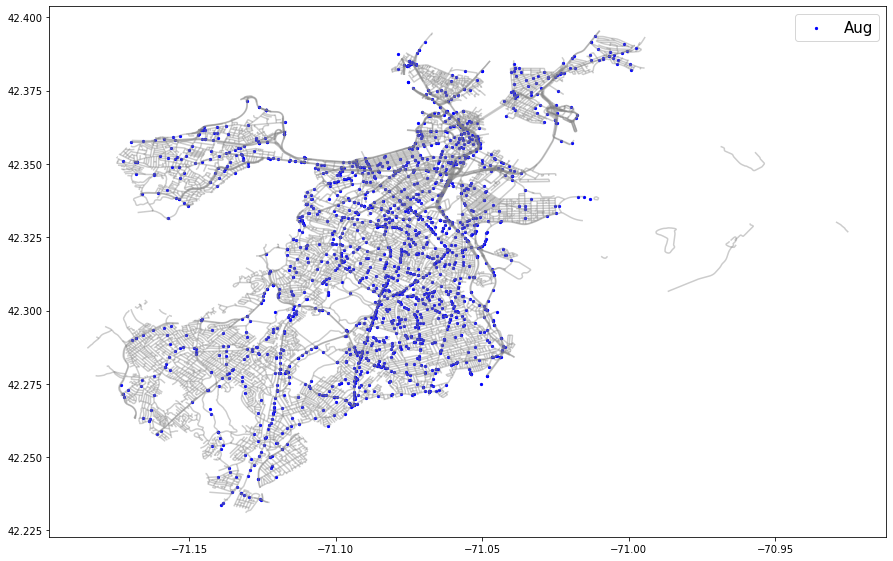

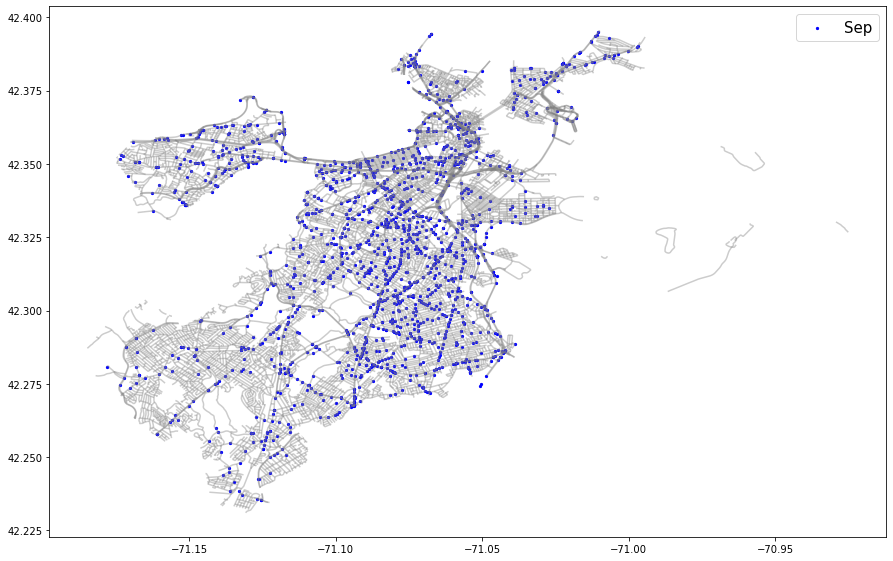

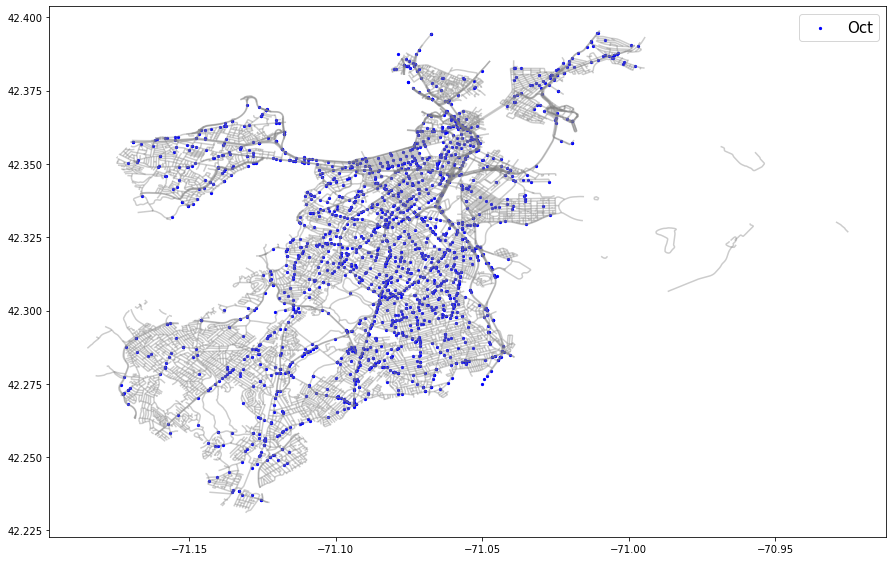

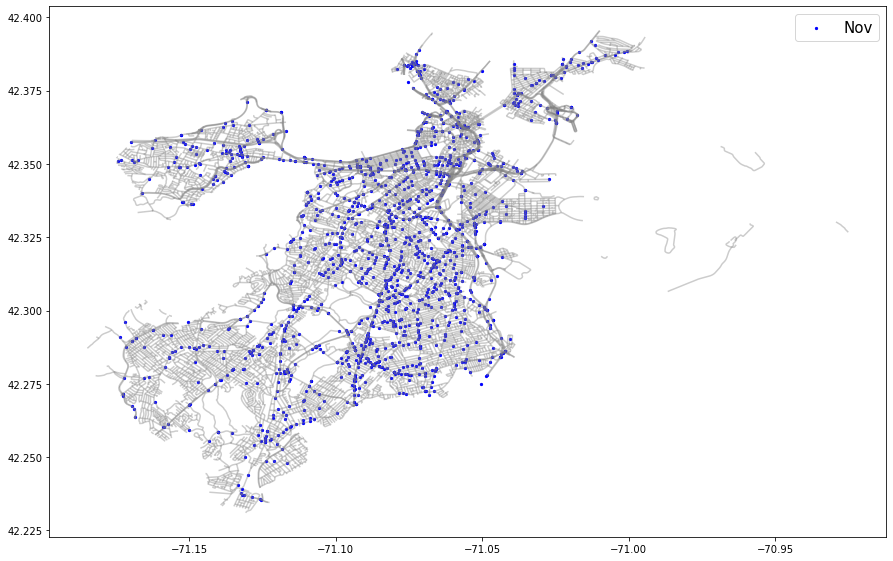

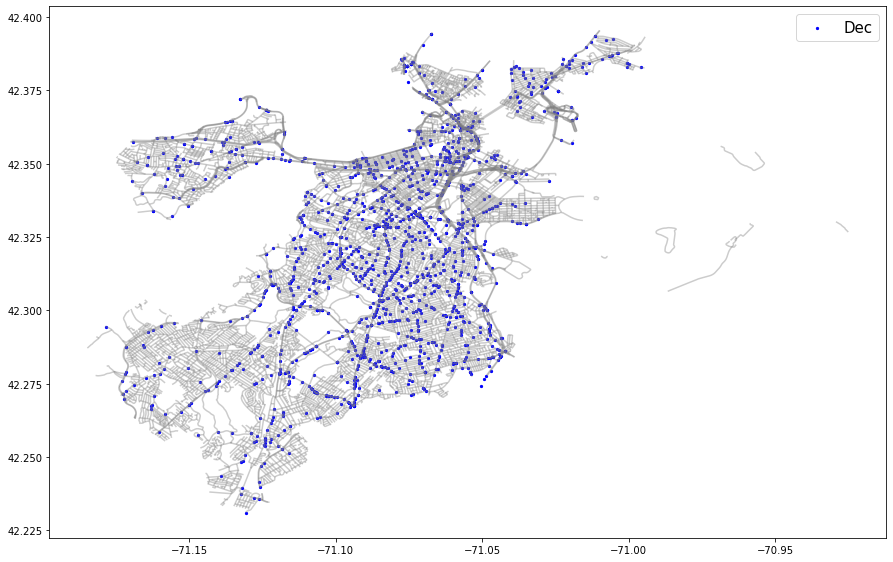

In [11]:
for i in range(1, len(month_names) + 1):
    street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
    fig, ax = plt.subplots(figsize=(15,15))
    street_map.plot(ax = ax, alpha = 0.4, color="grey")
    geo_df[(geo_df["month"] == i)].plot(ax = ax, markersize = 5, color="blue", marker="o", label=month_names[i - 1])
    plt.legend(prop={'size': 15})

# Hour Maps

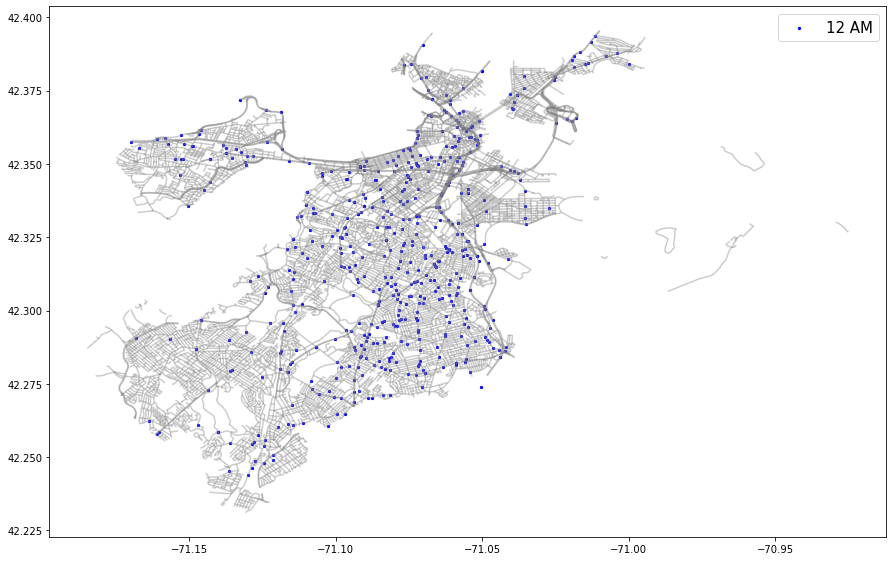

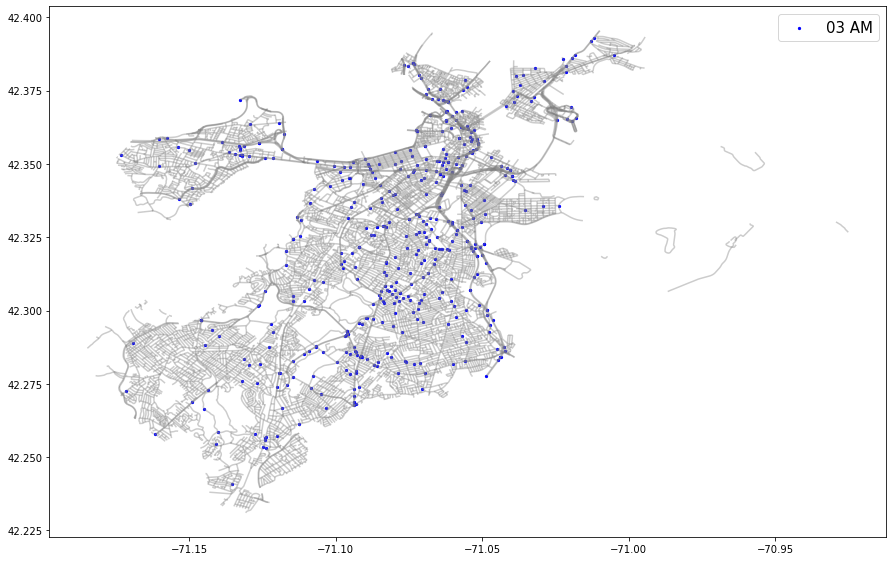

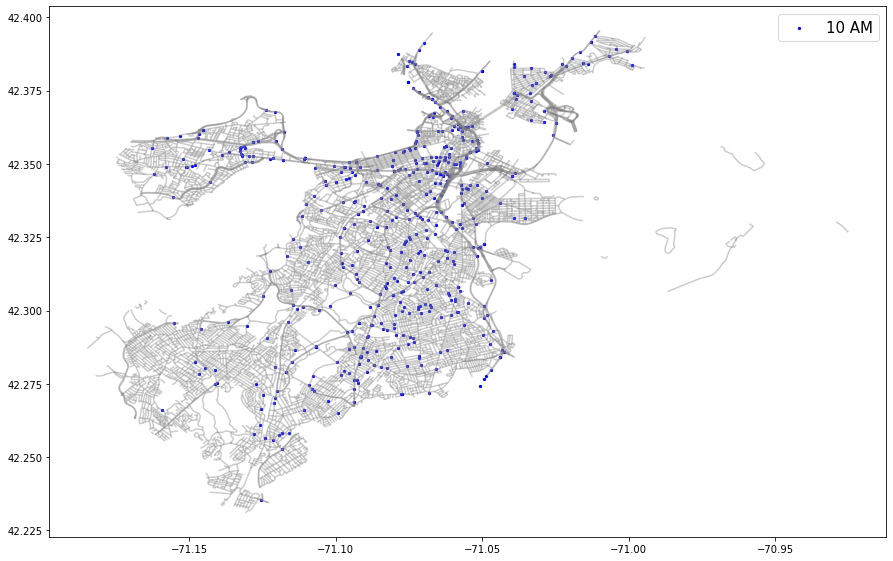

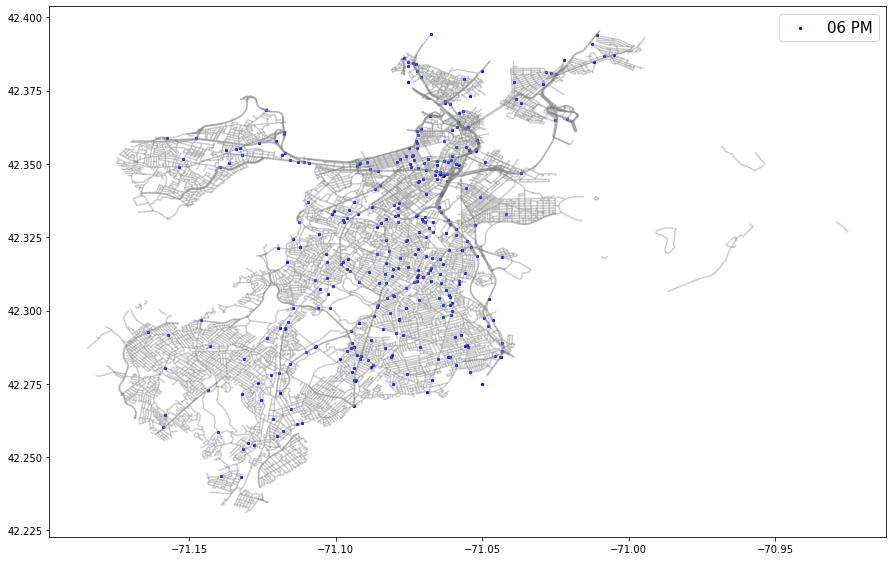

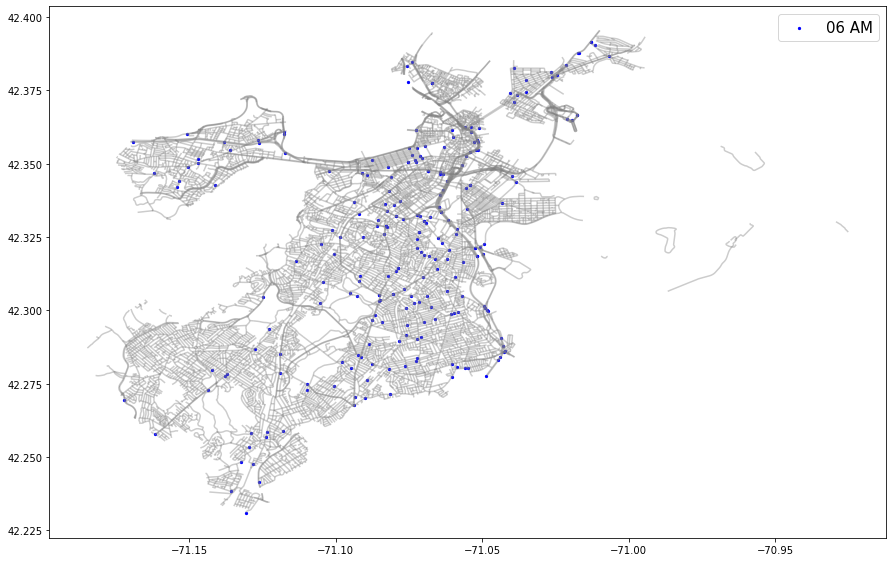

...

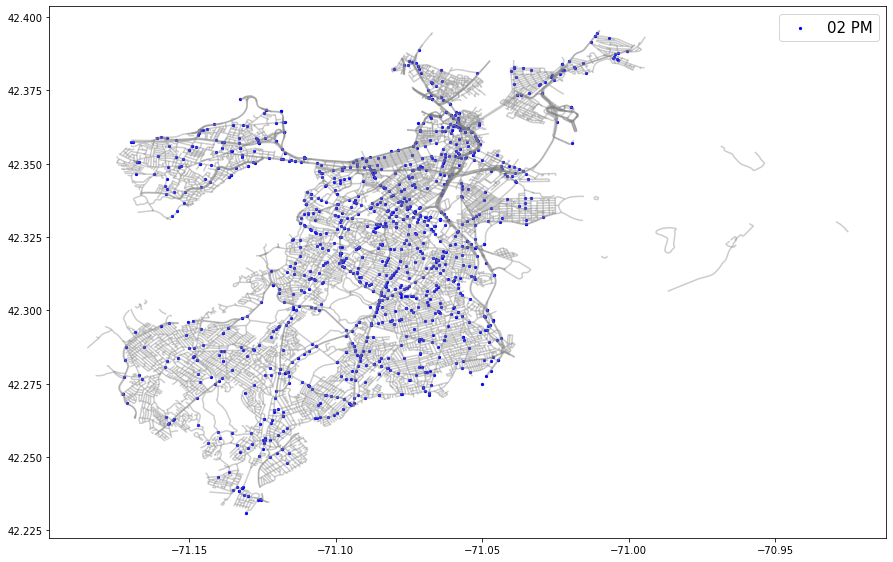

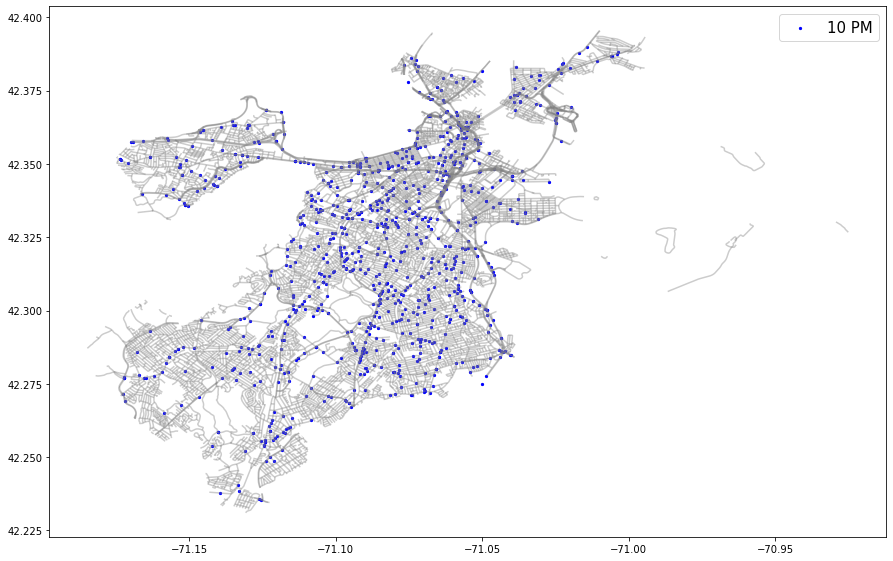

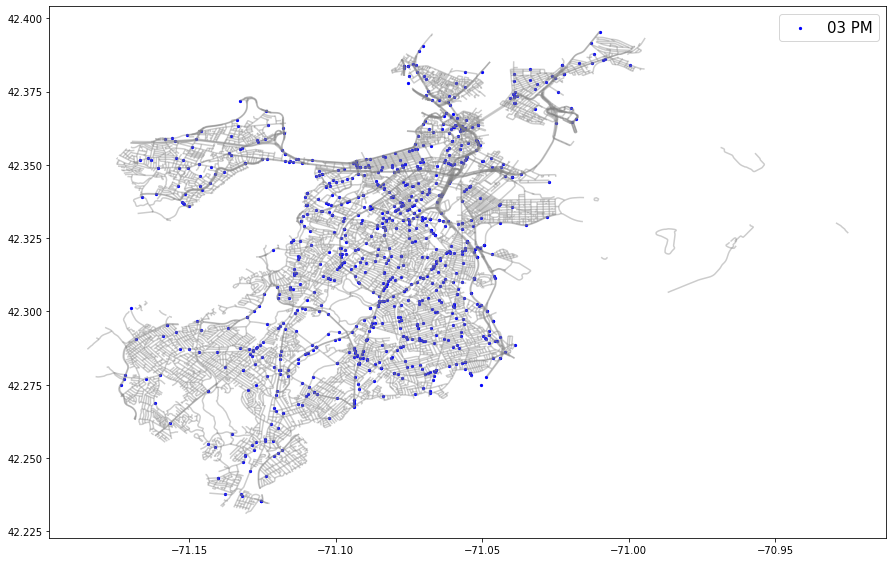

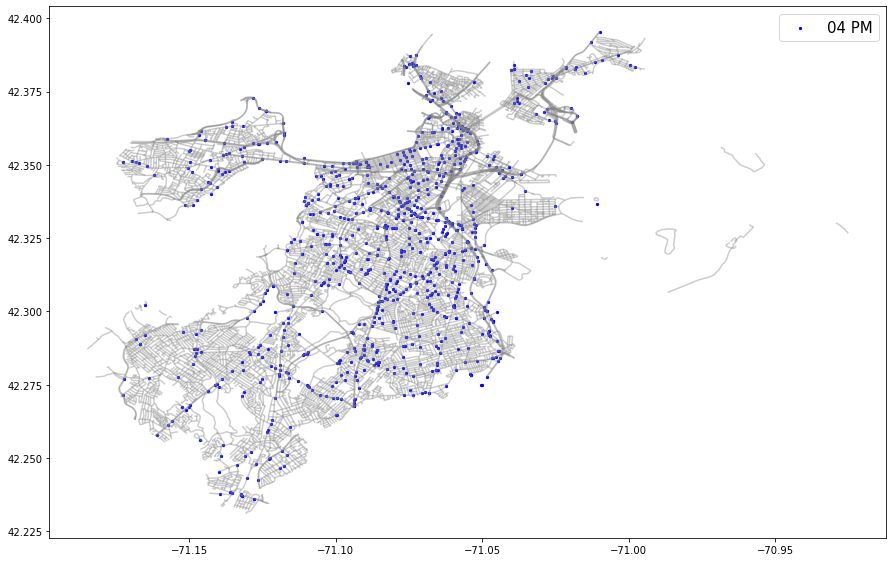

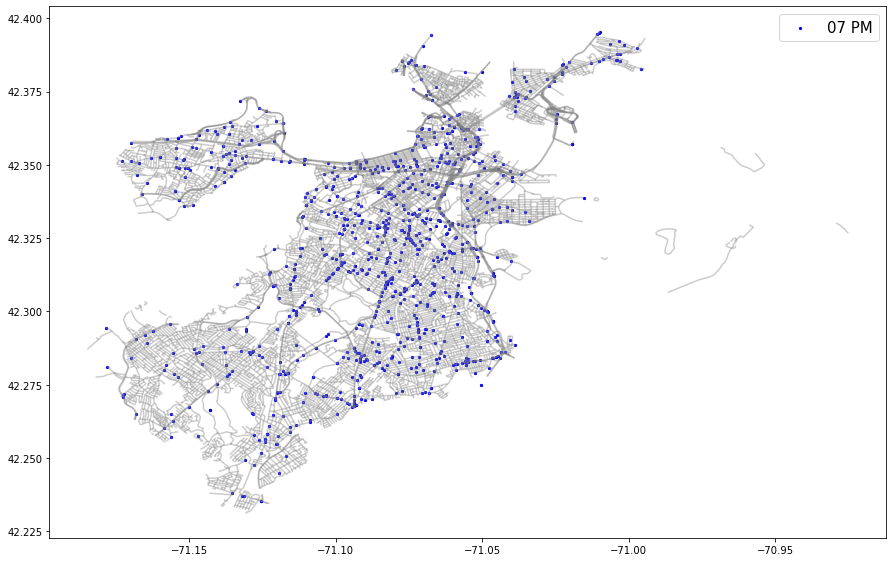

In [12]:
for i in range(13):
    street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
    fig, ax = plt.subplots(figsize=(15,15))
    street_map.plot(ax = ax, alpha = 0.4, color="grey")
    geo_df[(geo_df["hour"] == i)].plot(ax = ax, markersize = 5, color="blue", marker="o", label=times[i])
    plt.legend(prop={'size': 15})

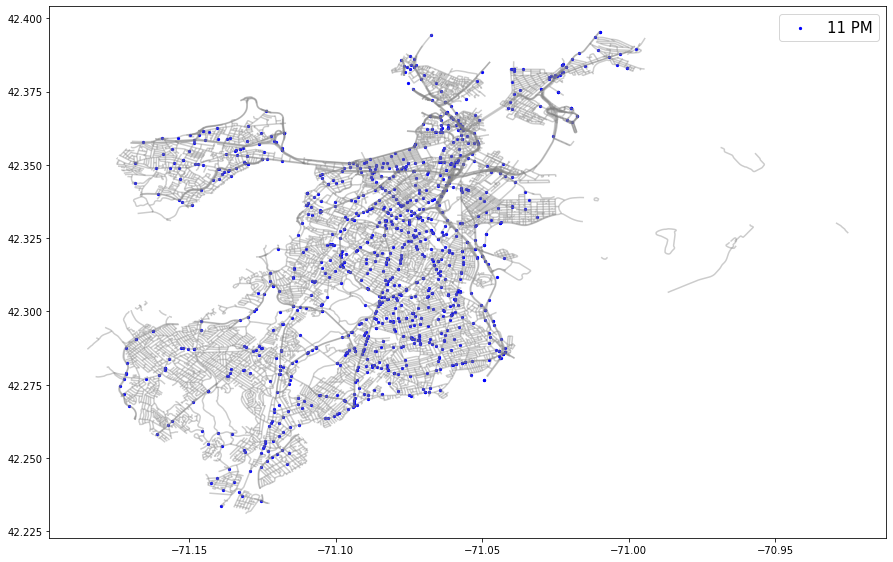

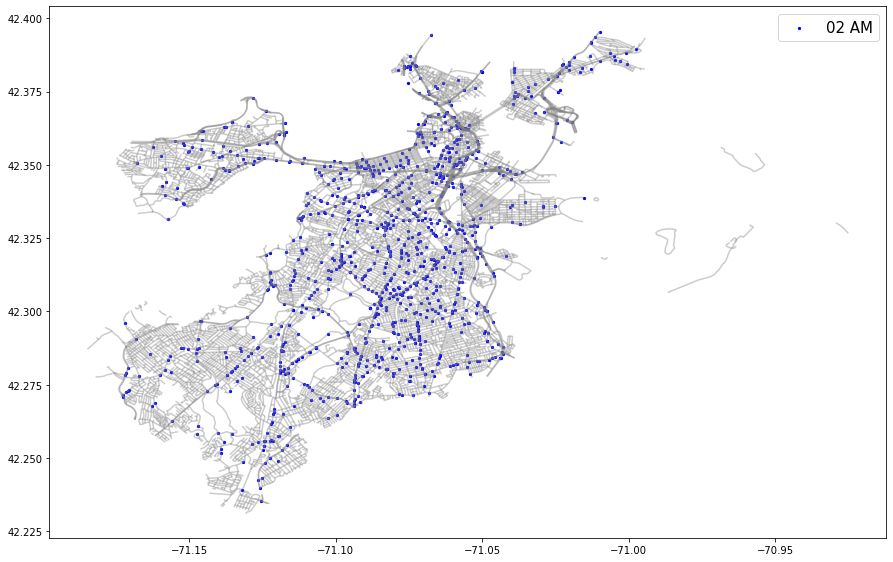

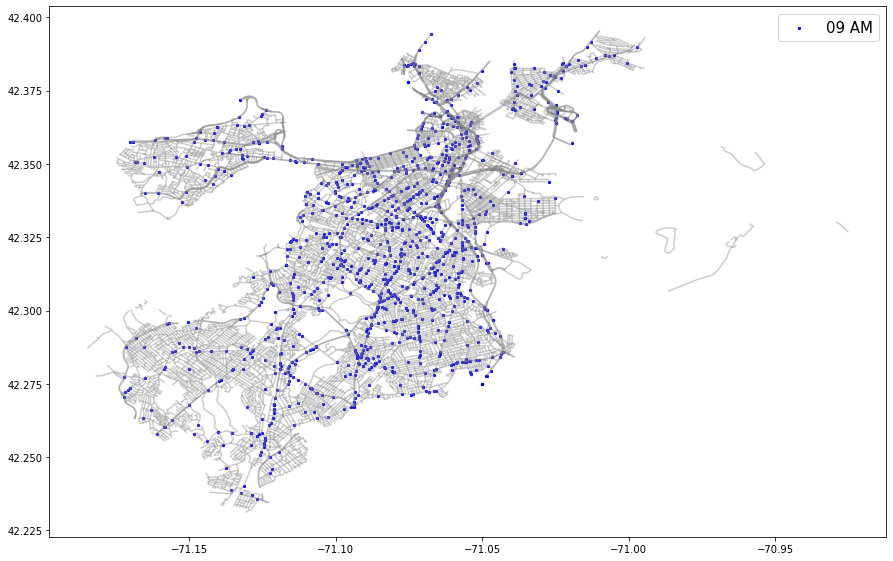

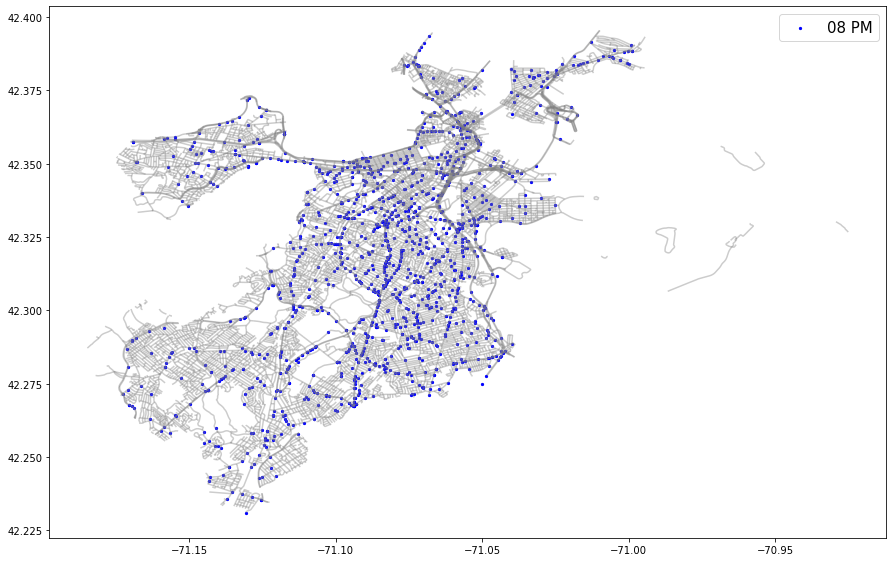

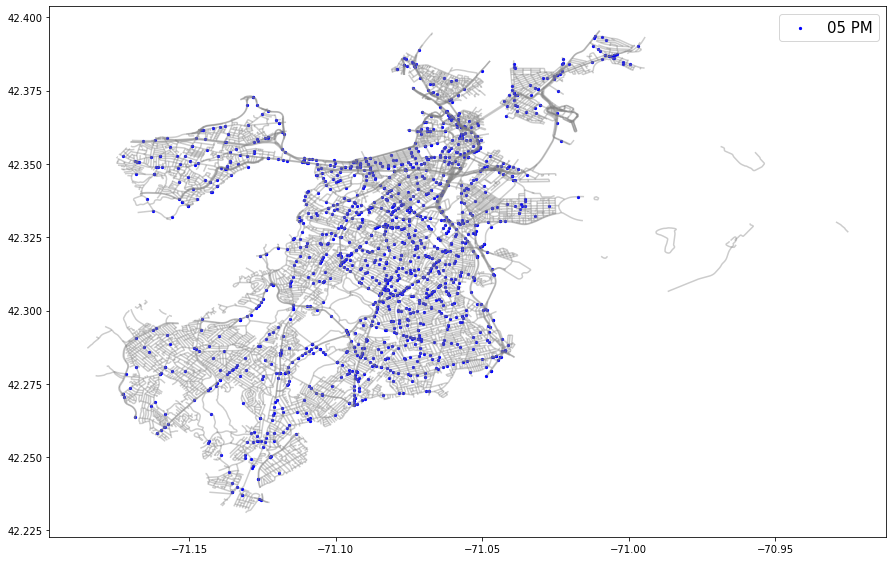

...

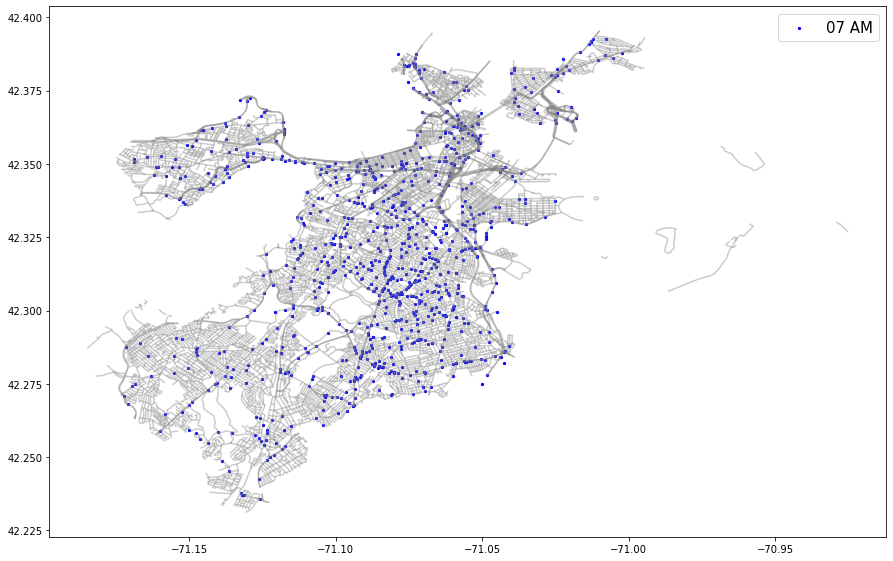

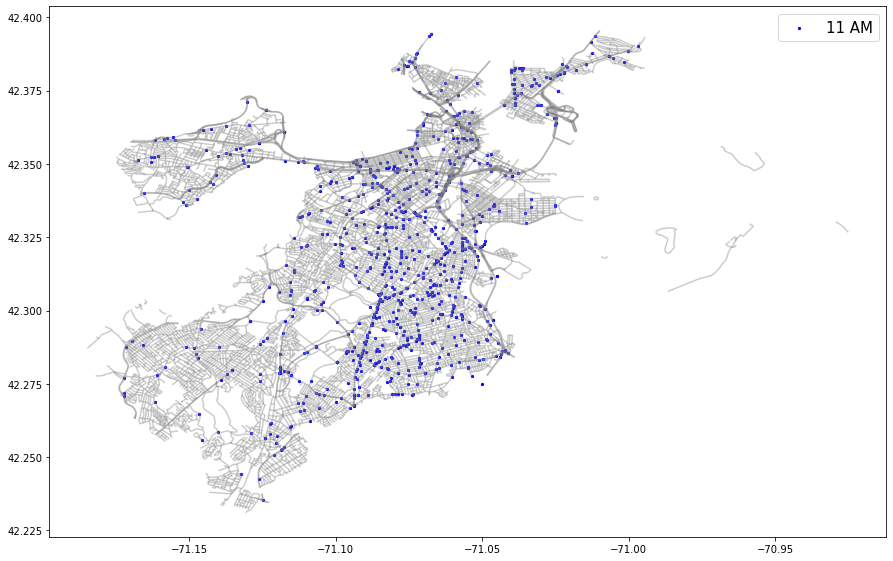

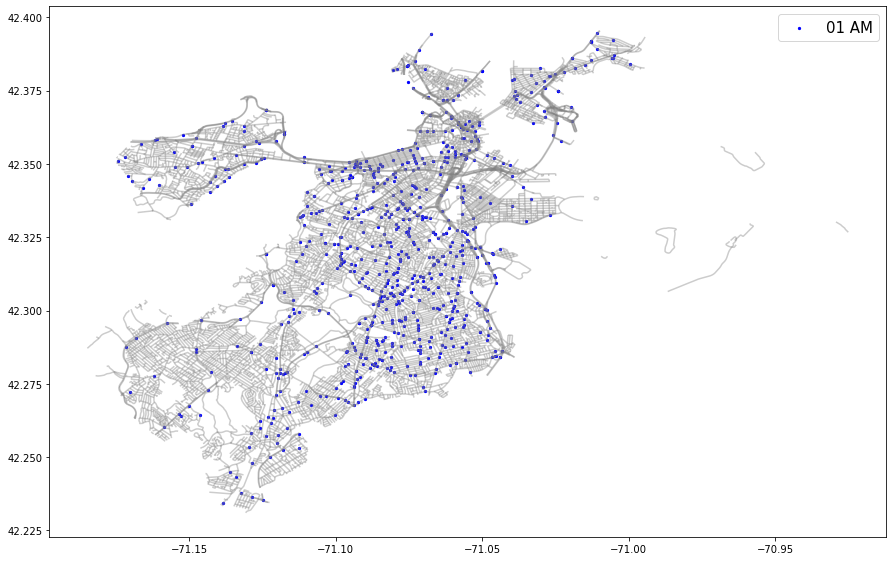

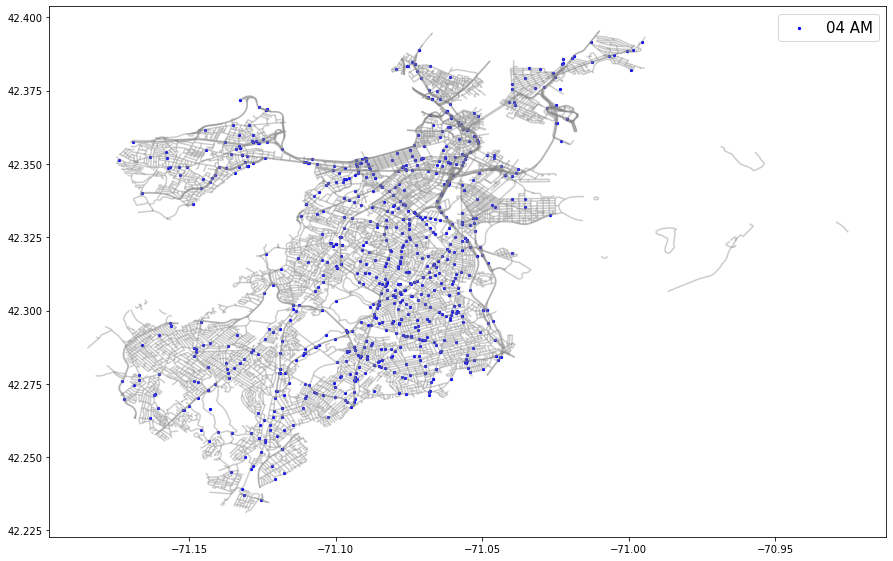

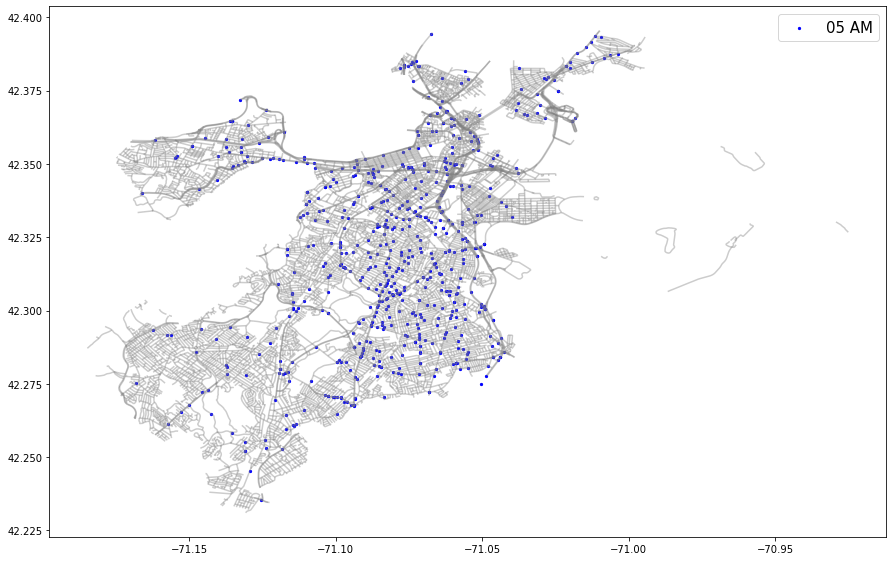

In [13]:
for i in range(13, len(times)):
    street_map = gpd.read_file('Boston_Street_Segments/Boston_Street_Segments.shp')
    fig, ax = plt.subplots(figsize=(15,15))
    street_map.plot(ax = ax, alpha = 0.4, color="grey")
    geo_df[(geo_df["hour"] == i)].plot(ax = ax, markersize = 5, color="blue", marker="o", label=times[i])
    plt.legend(prop={'size': 15})